# installs

In [ ]:
!python --version

Python 3.7.15


In [ ]:
# !pip install line_profiler

In [ ]:
# %load_ext line_profiler

In [ ]:
# !pip install memory_profiler

In [ ]:
# %load_ext memory_profiler

In [ ]:
# !pip install pycodestyle_magic

In [ ]:
# %load_ext pycodestyle_magic

In [ ]:
import matplotlib
matplotlib.__version__

'3.2.2'

In [ ]:
# !pip install -U matplotlib
#!pip install matplotlib==3.2.4

In [ ]:
!pip install geopandas
!pip install geopy
#!pip install alphashape
!pip install pygeos
!pip install h3
!pip install h3pandas

!pip install fiona 
!pip install shapely 
!pip install pyproj 
!pip install rtree

!pip install folium
!pip install missingno
!pip install sparklines
!pip install mapclassify

# !pip install osmnx

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.0 MB 15.7 MB/s 
     |████████████████████████████████| 6.3 MB 43.6 MB/s 
     |████████████████████████████████| 16.7 MB 616 kB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.1 MB 7.5 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.1 MB 22.5 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 75 kB 4.6 MB/s 
  Created wheel for h3pandas: filename=h3pandas-0.2.3-py3-none-any.whl size=17136 sha256=34ed9fe4034722f42f6d5b31eaa35b99602308ecd20882d7a637baea98ae5322
  Stor

In [ ]:
%%bash
VAR_SEARCH='h3|pandas|shapely|geopandas'
pip3 freeze | grep -E $VAR_SEARCH

geopandas==0.10.2
h3==3.7.4
h3pandas==0.2.3
pandas==1.3.5
pandas-datareader==0.9.0
pandas-gbq==0.13.3
pandas-profiling==1.4.1
sklearn-pandas==1.8.0


# imports

In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
from IPython.core.display import HTML
from IPython.display import Image, display
from IPython.utils.text import columnize
from IPython.display import clear_output

from google.colab import data_table

import os
import os.path
from pathlib import Path

from functools import partial
from collections import defaultdict
from itertools import takewhile
import more_itertools as mit
from operator import or_
from functools import reduce

import contextlib

import random
import datetime as dt
import time

from timeit import default_timer
from tqdm import tqdm

import math

# import gc
# import ctypes
# from multiprocessing import Process, Event, Value
# import psutil
import sys
from sys import getsizeof
import shutil
import tempfile

# import logging

import pickle
# import joblib
import gzip

import numpy as np
import pandas as pd
from pandas.api.types import is_numeric_dtype
from pandas.testing import assert_frame_equal

import geopandas as gpd

import h3pandas

from shapely.geometry import Polygon, Point, MultiPolygon
from shapely.ops import polygonize, unary_union
from shapely import wkt

# import alphashape
# from descartes import PolygonPatch

import matplotlib
import matplotlib.pyplot as plt
import matplotlib_venn as venn
import seaborn as sns

from sklearn.metrics import mean_squared_error, mean_absolute_error

# import statistics
from h3 import h3

import pygeos

import folium
from folium.plugins import HeatMap

import missingno as msno
from sparklines import sparklines
# import osmnx as ox

# settings

In [ ]:
# https://colab.research.google.com/notebooks/data_table.ipynb#scrollTo=jcQEX_3vHOUz
data_table.enable_dataframe_formatter()

In [ ]:
np.set_printoptions(precision=4)
np.set_printoptions(suppress=True)

In [ ]:
pd.set_option('max_colwidth', 512)
pd.set_option('display.max_columns', 64)
pd.set_option('display.max_rows', 108)
pd.set_option('display.precision', 5)
pd.set_option('float_format', '{:,.5f}'.format)
pd.options.mode.chained_assignment = None

In [ ]:
plt.style.use('seaborn')

In [ ]:
sns.set(context='notebook', style='darkgrid', palette='deep', font='sans-serif', font_scale=1, color_codes=False, rc=None)

In [ ]:
N_JOBS = os.cpu_count()
RANDOM_STATE = 42

In [ ]:
DATE_TIME_FORMAT = '%Y-%m-%d %H:%M:%S'

In [ ]:
COLAB = 1
USE_GDRIVE = 2
run_mode = {
    COLAB: True,
    USE_GDRIVE: True,
}
VERBOSE = 0

In [ ]:
random.seed(RANDOM_STATE)
np.random.seed(RANDOM_STATE)
os.environ['PYTHONHASHSEED'] = str(RANDOM_STATE)

## dirs

In [ ]:
# LOGGING_DIR='logs'
GOOGLE_DRIVE_DIR = '/content/drive/MyDrive/pm'

In [ ]:
dirs = {
    'cache': 'cache',
    'preprocessed': 'preprocessed',
    'source': 'source',
    'img': 'img',
    'osm': 'osm',
    'train': 'train',
    'temp': None,
}
for d, p in dirs.items():
    if not p:
        dirs[d] = tempfile.mkdtemp(prefix=f'tmp_{dt.datetime.utcnow().strftime("%Y%m%d_%H-%M-%S")}', dir='.')
    else:
        os.makedirs(p, exist_ok=True)

In [ ]:
save_dirs = {
    'cache': [True, True], # import/export
    'preprocessed': [True, True],
    'source': [True, False],
    'img': [False, True],
    'osm': [True, False],
    'train': [True, True],
    'temp': [False, False],
}


## logging

In [ ]:
# #logging.basicConfig(level=logging.INFO)
# os.makedirs(LOGGING_DIR, exist_ok=True)
# logging.basicConfig(
#     level=logging.DEBUG,
#     format='[{%(filename)s:%(lineno)d} %(levelname)s - %(message)s',
#     force=True,
#     handlers=[
#         logging.FileHandler(filename=f'{LOGGING_DIR}/ts_{dt.datetime.utcnow().strftime("%Y%m%d_%H-%M-%S")}.log', mode='w'),
#         logging.StreamHandler()
#     ]
# )
# logger = logging.getLogger(__name__)

In [ ]:
# logger.info('start logging')

## moscow specific

In [ ]:
MOSCOW_CENTER_POINT = (55.756261, 37.617731)
MOSCOW_CRS = f'+proj=tmerc +lat_0={MOSCOW_CENTER_POINT[0]} +lon_0={MOSCOW_CENTER_POINT[1]} +x_0=0 +y_0=0 +k_0=1. +a=6377397 +rf=299.15 +towgs84=396,165,557.7,-0.05,0.04,0.01,0 +no_defs +units=m'
# '+proj=tmerc +lat_0=55.6666666667 +lon_0=37.5 +x_0=0 +y_0=0 +k_0=1. +a=6377397 +rf=299.15 +towgs84=396,165,557.7,-0.05,0.04,0.01,0 +no_defs +units=m'


## osm

In [ ]:
WGS84_CRS = 4326

In [ ]:
MAP_ZIP_FILE_PATH = f'{dirs["osm"]}/RU-MOW-ccef5f5b-20221028-ru-shape.zip'
MAP_ZIP_LAYER_PATH = f'zip://{MAP_ZIP_FILE_PATH}!data/'

In [ ]:
gdf_map = dict()

# colab with gdrive

In [ ]:
run_mode[COLAB] = run_mode[USE_GDRIVE] = True

In [ ]:
if run_mode[USE_GDRIVE]:
  try:
      from google.colab import drive
      print('working in colab')
      run_mode[COLAB] = True    
      drive.mount('/content/drive')
      print('\tdrive mounted')
      if os.path.exists(GOOGLE_DRIVE_DIR):
        print('\tgdrive wd exists')
        run_mode[USE_GDRIVE] = True
        for d, rules in save_dirs.items():
            if rules[0]:
                d = dirs[d]
                !cp -ruv '{GOOGLE_DRIVE_DIR}/{d}' .
        print('\tcp - done')
        !ls -la
  except:
    print('no colab')
    run_mode[COLAB] = False
    run_mode[USE_GDRIVE] = False

# defs

## io

In [ ]:
def savepoint():
    for d, rules in save_dirs.items():
        if rules[1]:
            d = dirs[d]
            !cp -ruv '{d}' '{GOOGLE_DRIVE_DIR}/'

In [ ]:
def fp(b, fn):
    return str(Path(dirs[b], fn))

In [ ]:
def save_as_geojson(gdf, fn, b='cache', zip=True, save=True):
    file_path = fp(b, f'{fn}.geojson')
    gdf.to_file(file_path, driver='GeoJSON')
    !zip '{file_path}.zip' '{file_path}'
    if save:
        savepoint()

## pandas

In [ ]:
def rename_func(name):
    def decorator(func):
        func.__name__ = name
        return func
    return decorator

def q_at(y):
    @rename_func(f'q{y:0.2f}')
    def q(x):
        return x.quantile(y)
    return q

In [ ]:
def sparkline_str(x, excludes=('key',)):
    return ''.join(sparklines(np.histogram(x.dropna())[0])) if is_numeric_dtype(x) and x.name not in excludes else ''

In [ ]:
def describe(
    df,
    caption = '',
    quantiles=(.5,),
    format_dict = {
        'uniques#':'{0: .0f}', 
        'count':'{0: .0f}',
        #'mean':'{0: .2f}',
        #'std':'{0: .2f}',
        #'date': '{:%m-%Y}', 
        'nulls%': '{:.2%}',
        'nulls#': '{:.0f}',    
    },
):
    # pandas describe method substitution
    return (
        df.dtypes.to_frame('dtype')
            .join(
                df.nunique(dropna=True).to_frame('uniques#')
            )
            .join(
                df.isnull().agg(['mean', 'sum']).T.rename(columns = {'mean': 'nulls%', 'sum': 'nulls#'})
            )
            .join(
                df.apply(sparkline_str).to_frame('hist')
            )    
            .join(
                df.agg([
                    'count', 
                    'mean', 
                    'std',
                    #'skew',
                    'min',
                    'max',
                    *[q_at(i) for i in quantiles],
                    ]).T
            )
            .style
                .format(format_dict)
                #.hide_index()
                .bar(color='skyblue', vmin=0, vmax=df.shape[0], subset=['uniques#'], align='zero')        
                .bar(color='pink', vmin=0, vmax=1, subset=['nulls%'], align='zero')
                .bar(color='pink', vmin=0, vmax=df.shape[0], subset=['nulls#'], align='zero')
                .set_caption(caption)   
    )

In [ ]:
def print_value_counts(ds, ascending=False, dropna=False, normalize=False, greater_than=0, width=100):
    print(
        columnize(
            ds.value_counts(
                ascending=ascending,
                dropna=dropna,
                normalize=normalize,
            ).loc[lambda s: s > greater_than].to_frame().reset_index().astype('str').agg(' - '.join, axis=1).tolist(),
            displaywidth=width,
        )
    )

## geopandas

In [ ]:
def as_gdf_with_points(df, lon='lon', lat='lat', crs=WGS84_CRS):
    return gpd.GeoDataFrame(
        df, 
        geometry=gpd.points_from_xy(df[lon], df[lat], crs=WGS84_CRS),
        crs=WGS84_CRS
)


In [ ]:

@contextlib.contextmanager
def set_to_crs(gdfs, crs=WGS84_CRS):
    if not isinstance(gdfs, tuple):
        gdfs = (gdfs,)
    init_crss = []
    for gdf in gdfs:
        init_crss.append(gdf.crs)
        gdf.to_crs(crs, inplace=True)
    try:
        yield gdfs
    finally:
        for i, gdf in enumerate(gdfs):
            gdf.to_crs(init_crss[i], inplace=True)


## map_layer_reduced

In [ ]:
def reduced_layer(
    gdf_map, 
    layer_key, 
    boundary_key = None,
    layer_file = None,
    reduced_layer_file_parquet = None,
    mode='within',
    map_dir=dirs['cache'], 
    zip_root=MAP_ZIP_LAYER_PATH,
    reload=False,
):
    reduced_layer_key = f'{layer_key}_{boundary_key}' if boundary_key else layer_key
    if reload and reduced_layer_key in gdf_map:
        del gdf_map[reduced_layer_key]

    if reduced_layer_key in gdf_map:
        print('loaded from cache')
        return gdf_map[reduced_layer_key]

    reduced_layer_file_parquet = reduced_layer_file_parquet if reduced_layer_file_parquet else reduced_layer_key
    file_path_parquet = fp('cache', f'{reduced_layer_file_parquet}.parquet')
    if os.path.isfile(file_path_parquet):
        print(f'reduced [{reduced_layer_key}] loaded from {file_path_parquet}')
        gdf_map[reduced_layer_key] = gpd.read_parquet(file_path_parquet)
        return gdf_map[reduced_layer_key]

    if layer_key not in gdf_map:
        layer_file = layer_file if layer_file else layer_key.replace('_', '-')
        layer_file += '.shp'
        zip_path = f'{zip_root}{layer_file}'
        gdf_map[layer_key] = gpd.read_file(zip_path, encoding='utf-8')
        print(f'original [{layer_key}] loaded from {zip_path}')
        
    if not boundary_key:
        return gdf_map[layer_key]

    gdf = gdf_map[layer_key].copy()
    gdf.geometry = gdf.apply(lambda r: unary_union(r.geometry), axis=1)

    boundary = gdf_map[boundary_key]
    if hasattr(boundary, 'geometry'):
        boundary = boundary.geometry.unary_union
    if mode == 'within':
        gdf.drop(
            gdf[~gdf.geometry.within(boundary)].index,
            axis='index',
            inplace=True
        )
    elif mode == 'intersect':
        gdf.geometry = gdf.geometry.intersection(boundary)
        gdf.drop(
            gdf[gdf.is_empty].index,
            axis='index',
            inplace=True                
        )
    gdf_map[reduced_layer_key] = gdf
    gdf.to_parquet(file_path_parquet) # gdf.to_file(fn, driver='GeoJSON') 

    return gdf

# datasets

## wiki ao region stat 2022
- [Административно-территориальное деление Москвы](https://ru.wikipedia.org/wiki/%D0%A0%D0%B0%D0%B9%D0%BE%D0%BD%D1%8B_%D0%B8_%D0%BF%D0%BE%D1%81%D0%B5%D0%BB%D0%B5%D0%BD%D0%B8%D1%8F_%D0%9C%D0%BE%D1%81%D0%BA%D0%B2%D1%8B)

In [ ]:
# !ls '{dirs["source"]}'/wiki*.csv

In [ ]:
df_ao = pd.read_csv(
    fp('source', 'wiki_stat2022_ao.csv'),
    delimiter=';',
)
display(df_ao)
display(df_ao.info())

,ao_code,ao_name,area_km2_2012,population_2022,population_density_2022
0,ЦАО,Центральный,66.18000,779086,"11,773.03000"
1,САО,Северный,113.73000,1175229,"10,333.86000"
2,СВАО,Северо-Восточный,101.88000,1427597,"14,012.12000"
3,ВАО,Восточный,154.84000,1514420,"9,780.83000"
4,ЮВАО,Юго-Восточный,117.56000,1432839,"12,188.18000"
5,ЮАО,Южный,131.77000,1773425,"13,458.19000"
6,ЮЗАО,Юго-Западный,111.36000,1442971,"12,957.46000"
7,ЗАО,Западный,153.03000,1383853,"9,042.76000"
8,СЗАО,Северо-Западный,93.28000,1009217,"10,819.11000"
9,ЗелАО,Зеленоградский,37.20000,253687,"6,819.56000"


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12 entries, 0 to 11
Data columns (total 5 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   ao_code                  12 non-null     object 
 1   ao_name                  12 non-null     object 
 2   area_km2_2012            12 non-null     float64
 3   population_2022          12 non-null     int64  
 4   population_density_2022  12 non-null     float64
dtypes: float64(2), int64(1), object(2)
memory usage: 608.0+ bytes


None

In [ ]:
df_rs = pd.read_csv(
    fp("source", 'wiki_stat2022_region.csv'),
    delimiter=';',
)
display(df_rs.sample(5))
display(df_rs.info())

,id,region_name,ao_code,okato,oktmo,area_km2_2012,population_2022,population_density_2022,avr_living_m2_per_person_2010
95,117,Чертаново Южное,ЮАО,45296597000,45926000,9.38000,149210,"15,907.25000",15.40000
86,62,Москворечье-Сабурово,ЮАО,45296569000,45917000,9.30000,80631,"8,670.00000",17.90000
6,35,Измайлово,ВАО,45263570000,45307000,15.24000,107379,"7,045.87000",19.70000
67,111,Хорошёво-Мнёвники,СЗАО,45283582000,45371000,17.18000,175924,"10,240.05000",17.80000
59,93,Северный,СВАО,45280585000,45363000,10.29000,39030,"3,793.00000",22.20000


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 120 entries, 0 to 119
Data columns (total 9 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   id                             120 non-null    int64  
 1   region_name                    120 non-null    object 
 2   ao_code                        120 non-null    object 
 3   okato                          120 non-null    int64  
 4   oktmo                          120 non-null    int64  
 5   area_km2_2012                  120 non-null    float64
 6   population_2022                120 non-null    int64  
 7   population_density_2022        120 non-null    float64
 8   avr_living_m2_per_person_2010  120 non-null    float64
dtypes: float64(3), int64(4), object(2)
memory usage: 8.6+ KB


None

In [ ]:
df_rs[['okato', 'oktmo']] = df_rs[['okato', 'oktmo']].astype('str')

## map: RU-MOW-ccef5f5b-20221028-ru-shape
- https://wiki.openstreetmap.org/wiki/Map_features#Attributes
- https://docs.google.com/spreadsheets/d/e/2PACX-1vTAv39RP6hZWTaC8aU5vhXN64com_hN1ydLThPR0QvfDI6w0CHouYRnJrq7JSrn6xnKDdhTax23w4qd/pubhtml#

### layers preload

In [ ]:
!unzip -l $MAP_ZIP_FILE_PATH

In [ ]:
LAYERS_DICT = {
    'boundary_L4': 'boundary-polygon-lvl4.shp', # границы города
    'boundary_L5': 'boundary-polygon-lvl5.shp', # административные округа
    'boundary_L8': 'boundary-polygon-lvl8.shp', # районы
    'building_polygon': 'building-polygon.shp',  # Здания, отмеченные в виде полигонов
    'highway_line': 'highway-line.shp', # дороги
}

for i, layer in enumerate(LAYERS_DICT.keys()):
    path_to_layer = MAP_ZIP_LAYER_PATH + LAYERS_DICT[layer]
    gdf_map[layer] = gpd.read_file(path_to_layer, encoding='utf-8')
    print(f'[{i+1}/{len(LAYERS_DICT)}] LOADED {layer}')

[1/5] LOADED boundary_L4
[2/5] LOADED boundary_L5
[3/5] LOADED boundary_L8
[4/5] LOADED building_polygon
[5/5] LOADED highway_line


### границы boundary-polygon-lvl4/5/8 

#### overview

In [ ]:
# describe(gdf_map['boundary_L5'])

In [ ]:
# describe(gdf_map['boundary_L8'])

In [ ]:
gdf_map['boundary_L8'].crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

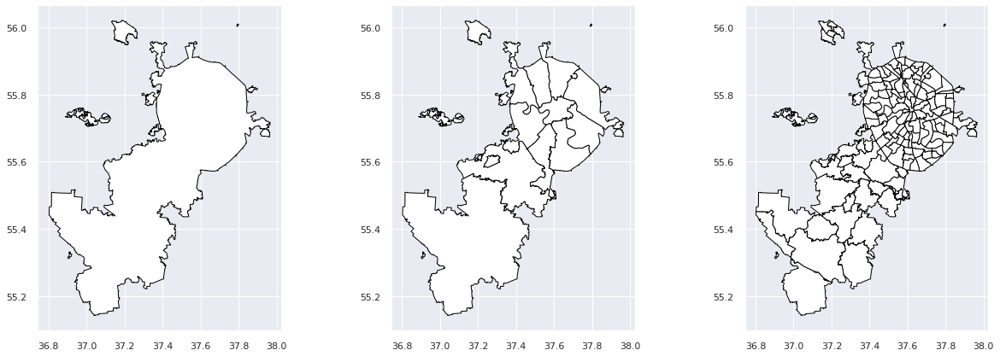

In [ ]:
_, (ax4, ax5, ax8) = plt.subplots(1, 3, figsize=(21,7))
gdf_map['boundary_L4'].plot(ax=ax4, color='white', edgecolor='black')
gdf_map['boundary_L5'].plot(ax=ax5, color='white', edgecolor='black')
gdf_map['boundary_L8'].plot(ax=ax8, color='white', edgecolor='black');

In [ ]:
base = gdf_map['boundary_L4'].plot(color='white', edgecolor='black', linewidth=6, figsize=(16,16))
base = gdf_map['boundary_L5'].plot(color='white', alpha=.5, edgecolor='blue', linewidth=4, ax=base);
gdf_map['boundary_L8'].plot(column='NAME_RU', alpha=.5, edgecolor='red', legend=True, linewidth=2, ax=base);

#### & stats

In [ ]:
gdf_map['boundary_L8'][gdf_map['boundary_L8']['oktmo'].isna()]

,NAME,NAME_EN,NAME_RU,ADMIN_LVL,OSM_TYPE,OSM_ID,ADMIN_L1D,ADMIN_L1,ADMIN_L2D,ADMIN_L2,ADMIN_L3D,ADMIN_L3,ADMIN_L4D,ADMIN_L4,ADMIN_L5D,ADMIN_L5,ADMIN_L6D,ADMIN_L6,ADMIN_L7D,ADMIN_L7,ADMIN_L8D,ADMIN_L8,ADMIN_L9D,ADMIN_L9,ADMIN_L10D,ADMIN_L10,oktmo,okato,geometry
91,район Бирюлёво Восточное,Biryulyovo Vostochnoye District,район Бирюлёво Восточное,8,relation,950639,None,None,None,None,None,None,102269,Москва,1282181,Южный административный округ,None,None,None,None,None,None,None,None,None,None,None,None,"POLYGON ((37.70106 55.58027, 37.70030 55.57999, 37.69940 55.57968, 37.69905 55.57955, 37.69644 55.57855, 37.69269 55.57716, 37.69256 55.57712, 37.69224 55.57687, 37.69209 55.57675, 37.69191 55.57661, 37.69179 55.57641, 37.69176 55.57619, 37.69168 55.57599, 37.69164 55.57581, 37.69160 55.57565, 37.69156 55.57550, 37.69151 55.57532, 37.69147 55.57510, 37.69142 55.57494, 37.69138 55.57478, 37.69138 55.57464, 37.69137 55.57444, 37.69136 55.57426, 37.69141 55.57410, 37.69145 55.57392, 37.69148 55.57379, 37.6..."
96,район Бирюлёво Западное,Biryulyovo Zapadnoye District,район Бирюлёво Западное,8,relation,950658,None,None,None,None,None,None,102269,Москва,1282181,Южный административный округ,None,None,None,None,None,None,None,None,None,None,None,None,"POLYGON ((37.61313 55.57463, 37.61456 55.58613, 37.61516 55.58993, 37.61524 55.59015, 37.61531 55.59036, 37.61534 55.59044, 37.61553 55.59088, 37.61574 55.59132, 37.61625 55.59198, 37.61711 55.59319, 37.61734 55.59340, 37.61780 55.59383, 37.61875 55.59454, 37.61935 55.59493, 37.62093 55.59579, 37.62341 55.59689, 37.62635 55.59820, 37.62731 55.59867, 37.62774 55.59893, 37.62836 55.59938, 37.63188 55.60298, 37.63241 55.60349, 37.63322 55.60425, 37.63511 55.60603, 37.63633 55.60720, 37.63746 55.60830, 37.6..."


In [ ]:
gdf_map['boundary_L8'].loc[91, ['oktmo', 'okato']] = df_rs.query('region_name == "Бирюлёво Восточное"')[['oktmo', 'okato']].iloc[0].tolist() # 91 район Бирюлёво Восточное
gdf_map['boundary_L8'].loc[96, ['oktmo', 'okato']] = df_rs.query('region_name == "Бирюлёво Западное"')[['oktmo', 'okato']].iloc[0].tolist() # 96 район Бирюлёво Западное

In [ ]:
gdf_map['boundary_L8'].loc[[91, 96], ['oktmo', 'okato']]

,oktmo,okato
91,45911000,45296553000
96,45912000,45296555000


In [ ]:
gdf_map['boundary_L8_base'] = (
    gdf_map['boundary_L8']
    [['oktmo', 'NAME_EN', 'NAME_RU', 'ADMIN_LVL', 'OSM_ID', 'ADMIN_L4D', 'ADMIN_L4', 'ADMIN_L5D', 'ADMIN_L5', 'geometry']]
    .merge(
        df_rs,
        how='inner',
        on='oktmo',    
    )
)

print(gdf_map['boundary_L8_base'].shape)
print(gdf_map['boundary_L8_base'].columns)
gdf_map['boundary_L8_base'].plot();

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(16,16))
#fig.subplots_adjust(right=0.8),
gdf_map['boundary_L8_base'].plot(
    column='population_density_2022', 
    edgecolor='blue',
    cmap='OrRd',
    #scheme='quantiles',
    linewidth=1, 
    ax=ax,
    #cax=cax,
    # legend_kwds={
    #     'label': "Плотность населения на 2022",
    #     'orientation': "horizontal",
    #     #'loc': 'upper left',
    #     #'bbox_to_anchor': (1, 1), 
    # },
).set(title='Плотность населения на 2022');
# ax.axis('off')
# # ax.annotate('Source: London Datastore, 2014',xy=(0.1, .08),  xycoords='figure fraction', horizontalalignment='left', verticalalignment='top', fontsize=12, color='#555555')
# #fig.tight_layout()
# #plt.show()

# sm = plt.cm.ScalarMappable(cmap='OrRd', norm=plt.Normalize(
#     vmin=gdf_map['boundary_L8_base'].population_density_2022.min(), 
#     vmax=gdf_map['boundary_L8_base'].population_density_2022.max()),
# )
# sm._A = []
# cbar = fig.colorbar(sm, ax=ax)

#### outer boundary

##### [base] with base regions (nearest to center)

In [ ]:
# region_osm_ids = gdf_map['boundary_L8_base']['OSM_ID'].tolist()
#dfm['boundary_L8_base'] = gdf_map['boundary_L8].query('OSM_ID in @region_osm_ids')

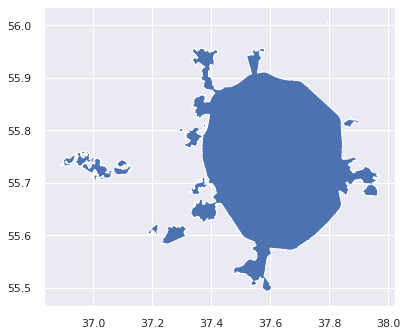

In [ ]:
outer_regions_boundary_polygon = gdf_map['boundary_L8_base'].geometry.unary_union
gdf_rb = gpd.GeoDataFrame(geometry=[outer_regions_boundary_polygon], crs=gdf_map['boundary_L8_base'].crs)
gdf_rb.plot();

##### + [base2] base reduced

In [ ]:
bounds = ((37.4, 55.4), (38., 55.4), (38., 55.98), (37.15, 55.98), (37.15, 55.7), (37.4, 55.6))

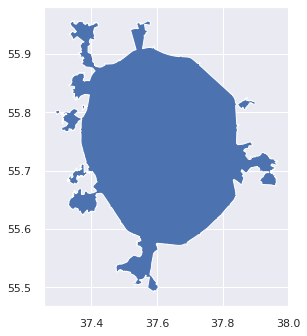

In [ ]:
gdf_rb.geometry.intersection(Polygon(bounds)).plot();

In [ ]:
gdf_map['base2_bounds'] = Polygon(bounds)

In [ ]:
gdf_map['base2'] = gdf_rb.geometry.intersection(Polygon(bounds))

In [ ]:
gdf_map['boundary_L8_base2'] = gdf_map['boundary_L8_base'].copy()

In [ ]:
gdf_map['boundary_L8_base2'].geometry = gdf_map['boundary_L8_base'].geometry.intersection(Polygon(bounds))
gdf_map['boundary_L8_base2'].shape

(120, 18)

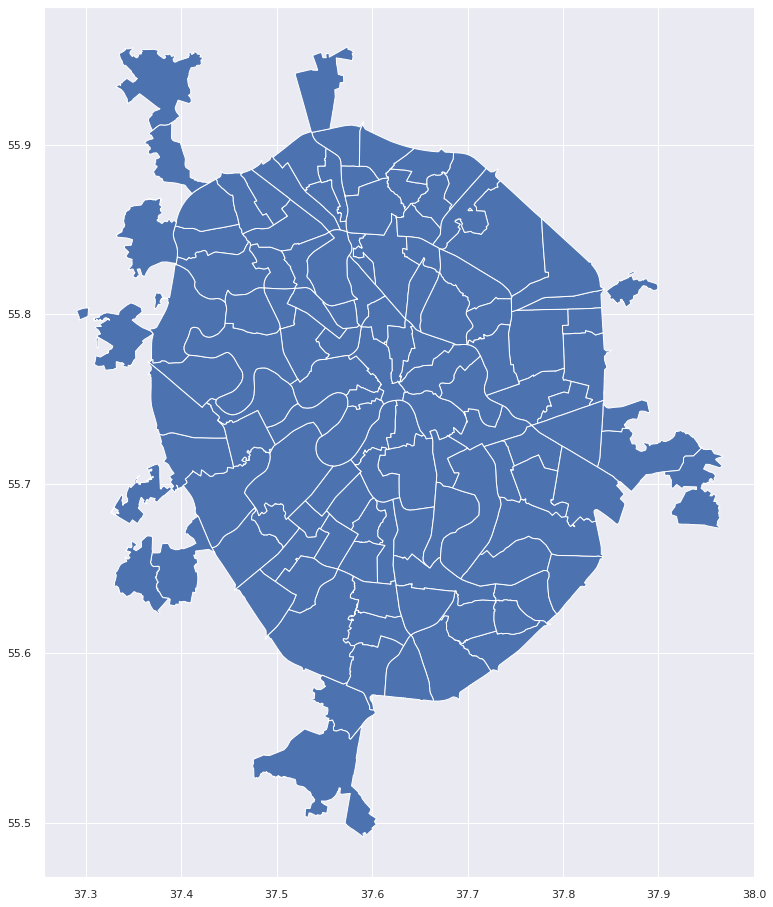

In [ ]:
gdf_map['boundary_L8_base2'].geometry.plot(figsize=(16,16));

In [ ]:
gdf_map['boundary_L8_base2'].drop(
    gdf_map['boundary_L8_base2'][gdf_map['boundary_L8_base2'].is_empty].index,
    inplace=True
)
gdf_map['boundary_L8_base2'].shape

(119, 18)

In [ ]:
gdf_map['boundary_L8_base2']['centroid_x'] = gdf_map['boundary_L8_base2'].geometry.centroid.x
gdf_map['boundary_L8_base2']['centroid_y'] = gdf_map['boundary_L8_base2'].geometry.centroid.y
gdf_map['boundary_L8_base2']['map_area_km2'] = gdf_map['boundary_L8_base2'].geometry.to_crs(MOSCOW_CRS).geometry.area / 10**6


In [ ]:
print('mae:', mean_absolute_error(gdf_map['boundary_L8_base2']['area_km2_2012'], gdf_map['boundary_L8_base2']['map_area_km2']))
print('rmse:', mean_squared_error(gdf_map['boundary_L8_base2']['area_km2_2012'], gdf_map['boundary_L8_base2']['map_area_km2'], squared=False))

mae: 0.38489267625940693
rmse: 1.077663883229269


In [ ]:
# for index, row in gdf_map['boundary_L8_base2'].iterrows():
#     gdf = gdf_map['boundary_L8_base2'].to_crs(
#         f'+proj=tmerc +lat_0={row.centroid_y} +lon_0={row.centroid_x} +x_0=0 +y_0=0 +k_0=1. +a=6377397 +rf=299.15 +towgs84=396,165,557.7,-0.05,0.04,0.01,0 +no_defs +units=m'
#     )
#     gdf_map['boundary_L8_base2'].loc[index, 'map_area_km2'] = gdf.loc[index].geometry.area / 10**6

In [ ]:
# import fiona
# fiona.supported_drivers

In [ ]:
# gdf_map['boundary_L8_base2'].to_parquet(fp("cache", 'moscow_regions_base2.parquet'))
# gdf_map['boundary_L8_base2'].to_file(fp("cache", 'moscow_regions_base2.geojson'), driver='GeoJSON') 
# savepoint()

In [ ]:
# load test
# gpd.read_parquet('moscow_regions_base2.parquet').geometry.plot();
# gpd.read_parquet('moscow_regions_base2.parquet').columns.tolist()

##### [inmkad] by mkad

In [ ]:
# describe(gdf_map['highway_line'])

In [ ]:
# gdf_map['highway_line'].plot(figsize=(128, 128))

In [ ]:
gdf_map['highway_line'].query('MAXSPEED == "100"').plot();

In [ ]:
# import matplotlib.pyplot as plt
# from shapely.geometry import MultiPolygon
# from shapely.ops import polygonize, unary_union

# multi = MultiPolygon(list(polygonize(my_gdf.geometry.iloc[0])))
# poly = unary_union(mp)

# ax = my_gdf.geometry.iloc[:1].plot()
# x,y = poly.exterior.xy
# ax.plot(x, y, color="orange")


In [ ]:
mkad_boundary_polygon = next(polygonize(gdf_map['highway_line'].query('MAXSPEED == "100"').geometry.unary_union))
mkad_boundary_polygon

In [ ]:
gdf_map['boundary_L8_inmkad'] = gdf_map['boundary_L8_base'].copy()

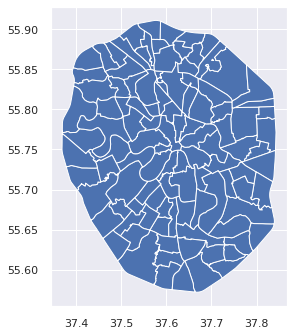

In [ ]:
gdf_map['boundary_L8_inmkad'].geometry = gdf_map['boundary_L8_inmkad'].geometry.intersection(mkad_boundary_polygon)
gdf_map['boundary_L8_inmkad'].geometry.plot();

In [ ]:
print(gdf_map['boundary_L8_inmkad'].shape)
gdf_map['boundary_L8_inmkad'].drop(
    gdf_map['boundary_L8_inmkad'][gdf_map['boundary_L8_inmkad'].is_empty].index,
    inplace=True
)
print(gdf_map['boundary_L8_inmkad'].shape)

(120, 18)
(108, 18)


In [ ]:
gdf_map['boundary_L8_inmkad']['centroid_x'] = gdf_map['boundary_L8_inmkad'].geometry.centroid.x
gdf_map['boundary_L8_inmkad']['centroid_y'] = gdf_map['boundary_L8_inmkad'].geometry.centroid.y
gdf_map['boundary_L8_inmkad']['map_area_km2'] = gdf_map['boundary_L8_inmkad'].geometry.to_crs(MOSCOW_CRS).geometry.area / 10**6

print('mae:', mean_absolute_error(gdf_map['boundary_L8_inmkad']['area_km2_2012'], gdf_map['boundary_L8_inmkad']['map_area_km2']))
print('rmse:', mean_squared_error(gdf_map['boundary_L8_inmkad']['area_km2_2012'], gdf_map['boundary_L8_inmkad']['map_area_km2'], squared=False))

# gdf_map['boundary_L8_inmkad'].to_parquet(str(Path(dirs["cache"], 'moscow_regions_inmkad.parquet')))
# gdf_map['boundary_L8_inmkad'].to_file(str(Path(dirs["cache"], 'moscow_regions_inmkad.geojson')), driver='GeoJSON')
# savepoint()

mae: 0.4365934184870206
rmse: 1.1719892607310214


In [ ]:
# test load
# gpd.read_parquet('moscow_regions_inmkad.parquet').plot();
# gpd.read_parquet('moscow_regions_inmkad.parquet').columns.tolist()

### h3

In [ ]:
def output_h3_id_attributes(h3_id):
    return {
        "co_ordinates" : h3.h3_to_geo(h3_id), 
        "geo_boundary" : Polygon(h3.h3_to_geo_boundary(h3_id, geo_json=True)).wkt, 
        "parent" : h3.h3_to_parent(h3_id), 
        "children" : h3.h3_to_children(h3_id)
    }

In [ ]:
# output_h3_id_attributes('8843acd819fffff')

In [ ]:
# h3_id = "8843a13687fffff"
# h3.k_ring(h3_id,1)
# #h3.k_ring(h3_id,2)

#### h3: 7, 8, 9, 10 (11)

In [ ]:
gdf_h3 = dict()

In [ ]:
# !ls -la cache/moscow_base2_h3_*

In [ ]:
min_res, max_res = 10, 7 
for res in range(min_res, max_res-1, -1):
    print(f'{res}'.center(32,'-'))
    if res == min_res:
        gdf_h3[res] = (
            gpd.GeoDataFrame(geometry=gdf_map['base2'])
            .h3.polyfill_resample(
                resolution = res, 
                return_geometry = True,
            )
            .drop(columns='index')
            .assign(h3_n_children=7)
        )
    else:
        gdf_h3[res] = (
            gdf_h3[res+1].h3.h3_to_parent(res)
            .groupby(f'h3_{res:02}')
            .agg({
                'h3_usefull_cell_area_km2': 'sum',
                'h3_n_children': 'count',
            })
            .h3.h3_to_geo_boundary()
        )
    print(f'count: {gdf_h3[res].shape[0]}')
    gdf_h3[res].index.rename('h3_index', inplace=True)
    gdf_h3[res]['h3_parent_index'] = gdf_h3[res].h3.h3_to_parent(res-1)[f'h3_{res-1:02}']
    gdf_h3[res]['h3_res'] = res

    gdf_h3[res]['h3_lat'], gdf_h3[res]['h3_lon'] =  zip(
        *gdf_h3[res].index.to_series().apply(h3.h3_to_geo)
    )
    # gdf_h3[res]['h3_centroid_lon'], gdf_h3[res]['h3_centroid_lat'] =  zip(
    #     *gdf_h3[res].geometry.centroid.apply(lambda s: s.coords[0])
    # )
    # (gdf_h3[res]['h3_geo_lat'] - gdf_h3[res]['h3_centroid_lat']).describe() = 0.0000

    gdf_h3[res]['h3_cell_area_km2'] = gdf_h3[res].index.to_series().apply(h3.cell_area, unit='km^2')
    display(gdf_h3[res]['h3_cell_area_km2'].apply(['mean', 'std', 'min', 'max']))
    #gdf_h3[res]['h3_crs_area_km2'] = gdf_h3[res].geometry.to_crs(MOSCOW_CRS).area / 10**6
    # (gdf_h3[res]['h3_cell_area_km2'] - gdf_h3[res]['h3_crs_area_km2']).describe()
    # # count   1,486.00000
    # # mean       -0.00325
    # # std         0.00001
    # # min        -0.00327
    if res == min_res:
        gdf_h3[res]['h3_usefull_cell_area_km2'] = gdf_h3[res]['h3_cell_area_km2']

    gdf_h3[res]['h3_edge_length_m'] =  np.sqrt(gdf_h3[res]['h3_cell_area_km2']*2/(3*3**.5)) * 1000
    display(gdf_h3[res]['h3_edge_length_m'].apply(['mean', 'std', 'min', 'max']))

    # gdf_h3[res]['h3_edge_length_m'] = gdf_h3[res].index.to_serias().apply(h3.exact_edge_length, unit='m')

    gdf_h3[res] = gdf_h3[res][[
        'h3_parent_index', 'h3_n_children',
        'h3_lat', 'h3_lon',
        'h3_cell_area_km2', 'h3_usefull_cell_area_km2', 
        'h3_edge_length_m', 
        'geometry'
    ]]

    # fn = f'cache/moscow_base2_h3_{res}.geojson'
    # gdf_h3[res].to_file(fn, driver='GeoJSON')
    # !ls -la $fn

---------------10---------------
count: 72945


mean   0.01410
std    0.00003
min    0.01404
max    0.01417
Name: h3_cell_area_km2, dtype: float64

mean   73.66959
std     0.06734
min    73.51529
max    73.84361
Name: h3_edge_length_m, dtype: float64

---------------9----------------
count: 10826


mean   0.09870
std    0.00018
min    0.09829
max    0.09917
Name: h3_cell_area_km2, dtype: float64

mean   194.90926
std      0.18257
min    194.50488
max    195.37212
Name: h3_edge_length_m, dtype: float64

---------------8----------------
count: 1677


mean   0.69087
std    0.00135
min    0.68801
max    0.69419
Name: h3_cell_area_km2, dtype: float64

mean   515.67024
std      0.50501
min    514.60192
max    516.90814
Name: h3_edge_length_m, dtype: float64

---------------7----------------
count: 280


mean   4.83581
std    0.01021
min    4.81548
max    4.85912
Name: h3_cell_area_km2, dtype: float64

mean   1,364.29604
std        1.44085
min    1,361.42579
max    1,367.57996
Name: h3_edge_length_m, dtype: float64

In [ ]:
# !zip cache/h3.zip cache/*.geojson
# savepoint()

In [ ]:
# h3_7_0 = gdf_h3[7].index[0]
# gdf = gdf_h3[7].query('h3_index == @h3_7_0')
# base = gdf.plot(color='white', edgecolor='red', alpha=.5, linewidth=4, figsize=(12, 12))

# gdf = gdf_h3[8].query(f'h3_parent_index == @h3_7_0')
# gdf.plot(color='white', alpha=.5, edgecolor='blue', linewidth=3, ax=base)

# children_list = gdf.index.tolist()
# gdf = gdf_h3[9].query(f'h3_parent_index in @children_list')
# gdf.plot(color='white', alpha=.5, edgecolor='green', linewidth=2, ax=base)

# children_list = gdf.index.tolist()
# gdf = gdf_h3[10].query(f'h3_parent_index in @children_list')
# gdf.plot(color='white', alpha=.5, edgecolor='black', linewidth=1, ax=base);


### roads



In [ ]:
%%time
gdf_roads = reduced_layer(gdf_map, 'highway_line', 'base2')

reduced [highway_line_base2] loaded from cache/highway_line_base2.parquet
CPU times: user 454 ms, sys: 197 ms, total: 652 ms
Wall time: 651 ms


In [ ]:
describe(gdf_roads)

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
NAME,object,4134,92.01%,277024,,24047,nan,nan,nan,nan,nan
NAME_EN,object,789,99.00%,298071,,3000,nan,nan,nan,nan,nan
NAME_RU,object,1766,96.98%,291972,,9099,nan,nan,nan,nan,nan
REF,object,112,99.86%,300656,,415,nan,nan,nan,nan,nan
HIGHWAY,object,24,0.00%,0,,301071,nan,nan,bridleway,unclassified,nan
ONEWAY,object,3,91.29%,274845,,26226,nan,nan,nan,nan,nan
BRIDGE,object,5,98.87%,297670,,3401,nan,nan,nan,nan,nan
TUNNEL,object,5,97.06%,292208,,8863,nan,nan,nan,nan,nan
MAXSPEED,object,21,94.59%,284787,,16284,nan,nan,nan,nan,nan
LANES,object,9,87.43%,263241,,37830,nan,nan,nan,nan,nan


#### MAXSPEED

In [ ]:
print_value_counts(gdf_roads['MAXSPEED'])

nan - 284787     40 - 819                5 - 483   50 - 104       15 - 13          20;60 - 1
RU:urban - 7057  80 - 799                10 - 230  70 - 52        RU:motorway - 7  68 - 1   
60 - 2718        RU:living_street - 680  30 - 176  110 - 19       3 - 2          
20 - 2416        100 - 557               90 - 134  RU:rural - 15  25 - 1         



#### LANES

In [ ]:
print_value_counts(gdf_roads['LANES'])

nan - 263241  1 - 17281  2 - 9638  3 - 4810  4 - 4525  5 - 1203  6 - 326  7 - 37  8 - 8  9 - 2



#### WIDTH

In [ ]:
print_value_counts(gdf_roads['WIDTH'])

nan - 296603  2.2 - 36  1.4 - 11   11 - 5    4 m - 2                         9.3 - 1            
1 - 852       7 - 32    2 m - 9    3.2 - 5   10.8 - 2                        4.6 - 1            
2 - 825       2.8 - 31  3.7 - 9    3 m - 5   0.9 - 2                         right side 3.04 - 1
3 - 607       6.5 - 30  7.6 - 8    9 - 4     100 - 2                         8.5 - 1            
1.5 - 373     5.5 - 26  2.7 - 7    3.1 - 4   right- 3.9 m, left - 2.0 m - 2  6.3 - 1            
4 - 327       0.7 - 21  1.0 - 7    1.1 - 4   40 - 2                          80 - 1             
5 - 200       1.8 - 17  12 - 6     1.6 - 4   11.25 - 2                       0.25 - 1           
2.5 - 199     10 - 16   0.75 - 6   7.7 - 4   3.8 - 1                         2.0 - 1            
1.2 - 164     0.4 - 15  0 - 6      7.8 - 4   4.3 - 1                         1.52 - 1           
0.5 - 156     0.3 - 14  3.6 - 6    60 - 3    4.4 - 1                         4.0 - 1            
6 - 83        0.6 - 13  1.5 m 

In [ ]:
gdf_roads['WIDTH'] = gdf_roads['WIDTH'].str.replace(r'[^0-9.]', '')

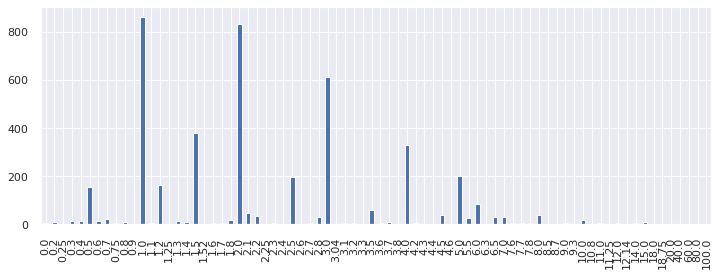

In [ ]:
gdf_roads.replace(
    {'WIDTH': {'3.92.0': '6'}},
    inplace=True,
)
gdf_roads['WIDTH'] = gdf_roads['WIDTH'].apply(lambda x: pd.to_numeric(x, errors='raise')).astype('float')
gdf_roads['WIDTH'].value_counts().sort_index().plot.bar(figsize=(12, 4));

#### HIGHWAY

In [ ]:
print_value_counts(gdf_roads['HIGHWAY'])

footway - 138910  tertiary - 6953        construction - 967   trunk - 719          raceway - 37  
service - 103343  residential - 4694     cycleway - 851       pedestrian - 517     bridleway - 34
path - 13649      primary - 3580         track - 849          trunk_link - 175     motorway - 25 
steps - 11581     unclassified - 3196    primary_link - 744   living_street - 105  road - 10     
secondary - 7875  secondary_link - 1413  tertiary_link - 743  proposed - 101     



In [ ]:
# https://wiki.openstreetmap.org/wiki/RU:Key:highway #'unclassified' 'residential'
main_roads = [
    #'road', 
    'motorway', 
    'primary', 
    'secondary', 
    'trunk', 
    'tertiary', 
    'cycleway', 
    'motorway_link', 
    'primary_link', 
    'secondary_link', 
    'trunk_link', 
    'tertiary_link'
]

In [ ]:
gdf_roads.query('(HIGHWAY == @main_roads) or (WIDTH > 2)').plot(column='HIGHWAY', legend=True, figsize=(20, 20));
plt.savefig(Path(dirs['img'], 'moscow_roads_HIGHWAY_main_20.png'))

#### outer_auto_gates

In [ ]:
# gdf_roads.query('HIGHWAY == "primary_link"').geometry.touches(gdf_roads.query('MAXSPEED == "100"'))
gdf_map['outer_auto_gates'] = gpd.read_file(fp('source', 'moscow_outer_auto_gate.geojson'))
gdf_map['outer_auto_gates'].explore()

In [ ]:
feature = 'HIGHWAY'
gdf_roads.plot(column=feature, legend=True, figsize=(64, 64))
# plt.savefig(fp('img', 'moscow_roads_HIGHWAY_64.png'))

### buildings
- 'building_point': 'building-point.shp',  # Здания, отмеченные в виде точек
- 'building_poly': 'building-polygon.shp',  # Здания, отмеченные в виде полигонов

#### points

In [ ]:
%%time
gdf_building_points = reduced_layer(gdf_map, 'building_point', 'base2')

reduced [building_point_base2] loaded from cache/building_point_base2.parquet
CPU times: user 13.5 ms, sys: 1.04 ms, total: 14.6 ms
Wall time: 16 ms


In [ ]:
describe(gdf_building_points)

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
BUILDING,object,28,0.00%,0,,1140,nan,nan,apartments,yes,nan
ADDR_CITY,object,1,97.19%,1108,,32,nan,nan,nan,nan,nan
A_STRT,object,91,81.67%,931,,209,nan,nan,nan,nan,nan
A_SBRB,object,0,100.00%,1140,,0,nan,nan,nan,nan,nan
A_HSNMBR,object,138,81.67%,931,,209,nan,nan,nan,nan,nan
A_PLACE,object,0,100.00%,1140,,0,nan,nan,nan,nan,nan
A_PSTCD,object,3,99.74%,1137,,3,nan,nan,nan,nan,nan
B_LEVELS,object,4,53.95%,615,,525,nan,nan,nan,nan,nan
NAME,object,77,83.07%,947,,193,nan,nan,nan,nan,nan
NAME_EN,object,8,95.88%,1093,,47,nan,nan,nan,nan,nan


In [ ]:
gdf_building_points.drop(columns='geometry')

,BUILDING,ADDR_CITY,A_STRT,A_SBRB,A_HSNMBR,A_PLACE,A_PSTCD,B_LEVELS,NAME,NAME_EN,NAME_RU,OSM_TYPE,OSM_ID
0,kiosk,None,None,None,None,None,None,None,None,None,None,node,5054342559
1,gazebo,None,None,None,None,None,None,1,None,None,None,node,5198642969
2,kiosk,None,None,None,None,None,None,None,None,None,None,node,5290514133
3,kiosk,None,None,None,None,None,None,1,None,None,None,node,5382888429
5,gazebo,None,None,None,None,None,None,None,None,None,None,node,5524981610
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1299,house,None,2-я Железногорская улица,None,6,None,None,None,None,None,None,node,966188443
1300,house,None,2-я Железногорская улица,None,20,None,None,None,None,None,None,node,966188475
1301,kiosk,None,None,None,None,None,None,1,None,None,None,node,811348872
1302,house,None,2-я Железногорская улица,None,4,None,None,None,None,None,None,node,966188440


In [ ]:
print_value_counts(gdf_building_points['BUILDING'])

kiosk - 630   bunker - 15            apartments - 3  hut - 1      residential - 1 
yes - 220     roof - 12              church - 3      shed - 1     ruins - 1       
house - 100   chapel - 11            public - 3      office - 1   cabin - 1       
service - 49  ventilation_kiosk - 5  tree_house - 2  toilets - 1  storage_tank - 1
gazebo - 37   industrial - 4         garages - 2     font - 1   
garage - 29   construction - 3       retail - 2      sty - 1    



In [ ]:
# points = ['kiosk', 'yes', 'house']
# base = gdf_map['boundary_L8_base2'].plot(color='white', edgecolor='red',  linewidth=2, figsize=(16,16))
# gdf_building_points.query('BUILDING == @points').plot(column='BUILDING', linewidth=4, legend=True, ax=base);
#plt.savefig(Path(dirs['img'], 'moscow_building_KIOSK_YES_HOUSE_points_16.png'))

#### polygons

In [ ]:
%%time
gdf_building_poly = reduced_layer(gdf_map, 'building_polygon', 'base2', reload=True)

reduced [building_polygon_base2] loaded from cache/building_polygon_base2.parquet
CPU times: user 281 ms, sys: 45.8 ms, total: 327 ms
Wall time: 282 ms


In [ ]:
%%time
describe(gdf_building_poly)

CPU times: user 17.8 s, sys: 708 ms, total: 18.5 s
Wall time: 18.5 s


,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
BUILDING,object,128,0.00%,0,,146282,nan,nan,abandoned,yes;service,nan
ADDR_CITY,object,50,79.60%,116441,,29841,nan,nan,nan,nan,nan
A_STRT,object,2993,36.84%,53890,,92392,nan,nan,nan,nan,nan
A_SBRB,object,9,99.88%,146106,,176,nan,nan,nan,nan,nan
A_HSNMBR,object,14817,37.03%,54163,,92119,nan,nan,nan,nan,nan
A_PLACE,object,23,99.77%,145949,,333,nan,nan,nan,nan,nan
A_PSTCD,object,509,90.73%,132726,,13556,nan,nan,nan,nan,nan
B_LEVELS,object,82,44.73%,65432,,80850,nan,nan,nan,nan,nan
NAME,object,7157,94.39%,138072,,8210,nan,nan,nan,nan,nan
NAME_EN,object,740,99.38%,145378,,904,nan,nan,nan,nan,nan


- A_HSNBR	Почтовый номер дома				
- A_PSTCD	Почтовый индекс
- B_LEVELS	Этажность

##### A_PSTCD

In [ ]:
print_value_counts(gdf_building_poly['A_PSTCD'], greater_than=100)

nan - 132726  115304 - 187  109559 - 158  109387 - 129  119049 - 115  111024 - 107
125466 - 280  115516 - 175  125480 - 152  127474 - 127  119002 - 114  109457 - 106
127238 - 279  127560 - 175  129090 - 147  109382 - 126  115477 - 114  111673 - 105
109052 - 264  125445 - 165  127562 - 141  109156 - 120  115191 - 111  121354 - 104
111674 - 209  109235 - 161  119034 - 135  109518 - 117  109386 - 109  125599 - 102
123060 - 205  121353 - 160  109147 - 130  111402 - 116  107140 - 109  117216 - 101



##### B_LEVELS

In [ ]:
print_value_counts(gdf_building_poly['B_LEVELS'])

nan - 65432  17 - 2139  11 - 212  28 - 20   0 - 9    52 - 3          79 - 1      3, 4 - 1  85 - 1 
1 - 24812    6 - 1834   13 - 178  27 - 19   34 - 8   41 - 3          5;3;2 - 1   8.5 - 1   53 - 1 
2 - 10948    8 - 1368   23 - 157  31 - 15   3.5 - 5  36 - 3          54 - 1      8-15 - 1  4-6 - 1
5 - 10793    7 - 1179   19 - 144  0.5 - 14  47 - 5   переменное - 2  2;8;12 - 1  75 - 1  
3 - 6455     22 - 700   20 - 139  29 - 14   48 - 4   69 - 2          57 - 1      76 - 1  
9 - 5006     10 - 576   21 - 70   39 - 13   5.5 - 4  9.5 - 2         63 - 1      71 - 1  
4 - 4351     25 - 360   30 - 34   35 - 12   38 - 4   59 - 2          95 - 1      62 - 1  
12 - 3734    18 - 298   26 - 29   2.5 - 10  40 - 4   60 - 2          2, 3 - 1    45 - 1  
14 - 2323    15 - 292   33 - 25   1.5 - 10  58 - 4   -1 - 2          12-14 - 1   7.5 - 1 
16 - 2196    24 - 242   32 - 24   4.5 - 10  37 - 3   2,3 - 1         6.5 - 1     49 - 1  



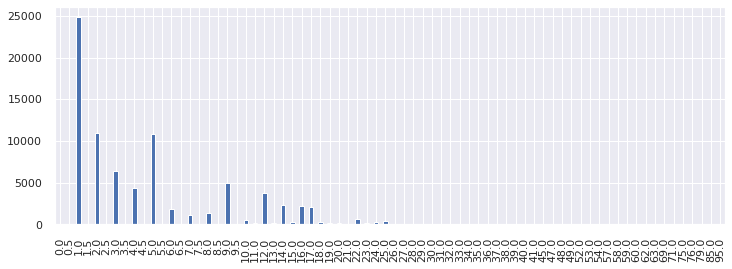

In [ ]:
gdf_building_poly.replace(
    {'B_LEVELS': {'переменное': np.NaN, '-1': np.NaN, '2,3': '2.5', '2, 3': '2.5', '3, 4': '3.5', '5;3;2': '5', '2;8;12': '12', '12-14':'13', '8-15': '11', '4-6': '5'}},
    inplace=True,
)
gdf_building_poly['B_LEVELS'] = gdf_building_poly['B_LEVELS'].apply(lambda x: pd.to_numeric(x, errors='raise')).astype('float')
gdf_building_poly['B_LEVELS'].value_counts().sort_index().plot.bar(figsize=(12, 4));

In [ ]:
gdf_building_poly['B_LEVELS'].value_counts(bins=5)

(-0.096, 19.0]    78913
(19.0, 38.0]       1878
(38.0, 57.0]         37
(57.0, 76.0]         15
(76.0, 95.0]          3
Name: B_LEVELS, dtype: int64

In [ ]:
# pd.qcut(gdf_building_poly['B_LEVELS'], q=5)

##### BUILDING

In [ ]:
print_value_counts(gdf_building_poly['BUILDING'])

yes - 75089           government - 86         collapsed - 6              signal_box - 1        
apartments - 29963    civic - 74              undefined - 6              gate - 1              
garages - 7992        ruins - 72              observatory - 6            fuel_station - 1      
service - 5987        chapel - 71             factory - 6                offices - 1           
industrial - 5939     gazebo - 52             dovecote - 6               data_center - 1       
house - 2817          sports_centre - 52      storage_tank - 6           ice_rink - 1          
roof - 2099           terrace - 48            lift - 6                   community_centre - 1  
office - 1992         clinic - 44             mall - 6                   chimney - 1           
retail - 1846         toilets - 43            supermarket - 5            embassy - 1           
kindergarten - 1835   store - 41              water_works - 5            silo - 1              
commercial - 1822     stable - 40       

In [ ]:
gdf_building_poly.drop(columns='geometry').sample(5)

,BUILDING,ADDR_CITY,A_STRT,A_SBRB,A_HSNMBR,A_PLACE,A_PSTCD,B_LEVELS,NAME,NAME_EN,NAME_RU,OSM_TYPE,OSM_ID
237217,yes,None,Перовская улица,None,53/49,None,None,6.00000,None,None,None,way,29446149
205936,yes,None,Денисовский переулок,None,23 с6,None,None,2.00000,None,None,None,way,53162062
6021,yes,None,Рублёвское шоссе,None,72 с1,None,None,NaN,None,None,None,way,55353689
237230,yes,None,3-я Владимирская улица,None,24,None,None,2.00000,None,None,None,way,29446165
172357,hospital,Москва,1-й Пехотный переулок,None,9/27 с3,None,None,4.00000,None,None,None,way,159148955


In [ ]:
buildings = [
    'apartments',
    'house',

    'retail',

    'commercial',
    'office',
    'service',

    'industrial',
    'garages',

    'university',
    'school',
    'kindergarten',

    'dormitory',
    'hospital',

    'warehouse',
]
base = gdf_map['boundary_L8_base2'].plot(color='white', edgecolor='red', label='region', legend=True, linewidth=2, linestyle='--', figsize=(128,128))
gdf_roads.query('HIGHWAY == @main_roads').plot(edgecolor='black', label='roads', legend=True, ax=base)
gdf_building_poly.query(f'BUILDING == @buildings').plot(column='BUILDING', legend=True, ax=base)
#gdf_h3[7].plot(edgecolor='green', alpha=.5, linewidth=3, ax=base)
#gdf_h3[8].plot(alpha=.8, edgecolor='blue', linewidth=2, ax=base)
gdf_h3[9].plot(alpha=.2, edgecolor='blue', linewidth=1, ax=base)
# plt.savefig(fp('img', 'moscow_main_roads_buildings_h3_9.png'))

In [ ]:
_, ax = plt.subplots(1,1,figsize=(64,64))
ax.set_xlim(37.6, 37.73)
ax.set_ylim(55.826, 55.8844)

gdf_map['boundary_L8_base2'].plot(color='white', edgecolor='red', label='region', legend=True, linewidth=2, linestyle='--', ax=ax)
gdf_roads.plot(edgecolor='black', label='roads', legend=True, ax=ax)
gdf_building_poly.plot(column='BUILDING', legend=True, ax=ax)
#gdf_h3[7].plot(edgecolor='green', alpha=.5, linewidth=3, ax=ax)
#gdf_h3[8].plot(alpha=.8, edgecolor='blue', linewidth=2, ax=ax)
gdf_h3[9].plot(alpha=.2, edgecolor='blue', linewidth=1, ax=ax)
leg = ax.get_legend()
leg.set_bbox_to_anchor((1.1,1))
plt.savefig(fp('img', 'moscow_roads_buildings_h3_9_fragment_64.png'))

#### kiosk

In [ ]:
gdf_osm_kiosk_points = gdf_building_points.query('BUILDING == "kiosk"')
gdf_osm_kiosk_points.shape

(630, 14)

In [ ]:
gdf_osm_kiosk_poly = gdf_building_poly.query('BUILDING == "kiosk"')
gdf_osm_kiosk_poly.shape

(348, 14)

In [ ]:
gdf_osm_kiosk_points[gdf_osm_kiosk_points.geometry.within(gdf_osm_kiosk_poly.geometry)].shape
# gdf_osm_kiosk_poly[gdf_osm_kiosk_poly.contains(gdf_osm_kiosk_points)]

(0, 14)

In [ ]:
gdf_osm_kiosk_poly.geometry = gdf_osm_kiosk_poly.geometry.centroid
gdf_osm_kiosk_points = gdf_osm_kiosk_points.append(gdf_osm_kiosk_poly, verify_integrity=True, ignore_index=True)
gdf_osm_kiosk_points.shape

(978, 14)

In [ ]:
gdf_kiosk = as_gdf_with_points(
    pd.read_csv(
        fp('source', 'Киоски Москва.csv'),
        delimiter=';',
        encoding='cp1251',
        #skiprows=1,
        usecols=('name', 'geometry_name', 'lon', 'lat'),
    ),
).assign(obj_type = 'kiosk')

In [ ]:
with set_to_crs((gdf_kiosk, gdf_osm_kiosk_points), MOSCOW_CRS):
    gdf_osm_kiosk_points.geometry = gdf_osm_kiosk_points.geometry.buffer(5)
    print(gdf_osm_kiosk_points.geometry.contains(gdf_osm_kiosk_points).sum(), gdf_osm_kiosk_points.shape[0]) 

978 978


### points of interest
- [man_made](https://wiki.openstreetmap.org/wiki/RU:Key:man_made)
- [sport](https://wiki.openstreetmap.org/wiki/RU:Key:sport)
- [tourism](https://wiki.openstreetmap.org/wiki/RU:Key:tourism)
- [office](https://wiki.openstreetmap.org/wiki/RU:Key:office)
- [amenity](https://wiki.openstreetmap.org/wiki/RU:Key:amenity)
- [...]()


#### points

In [ ]:
gdf_poi_points = reduced_layer(gdf_map, 'poi_point', 'base2')

reduced [poi_point_base2] loaded from cache/poi_point_base2.parquet


In [ ]:
describe(gdf_poi_points)

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
NAME,object,27717,53.99%,63451,,54072,nan,nan,nan,nan,nan
NAME_EN,object,2811,91.74%,107821,,9702,nan,nan,nan,nan,nan
NAME_RU,object,1989,91.22%,107202,,10321,nan,nan,nan,nan,nan
MAN_MADE,object,59,95.83%,112623,,4900,nan,nan,nan,nan,nan
LEISURE,object,41,96.13%,112978,,4545,nan,nan,nan,nan,nan
AMENITY,object,178,43.78%,51447,,66076,nan,nan,nan,nan,nan
OFFICE,object,70,95.72%,112489,,5034,nan,nan,nan,nan,nan
SHOP,object,269,71.45%,83968,,33555,nan,nan,nan,nan,nan
TOURISM,object,20,96.12%,112966,,4557,nan,nan,nan,nan,nan
SPORT,object,128,99.29%,116689,,834,nan,nan,nan,nan,nan


In [ ]:
gdf_poi_points.drop(columns='geometry').head(5)

,NAME,NAME_EN,NAME_RU,MAN_MADE,LEISURE,AMENITY,OFFICE,SHOP,TOURISM,SPORT,OSM_TYPE,OSM_ID
1,Лукойл,None,None,None,None,fuel,None,None,None,None,node,40903852
2,Кассы метро,None,None,None,None,None,None,ticket,None,None,node,317159079
3,BP Марьина Роща,None,None,None,None,fuel,None,None,None,None,node,141008920
4,None,None,None,None,None,clock,None,None,None,None,node,170533049
5,None,None,None,None,None,parking,None,None,None,None,node,317438243


In [ ]:
for feature in ['AMENITY', 'LEISURE', 'MAN_MADE', 'OFFICE', 'SHOP', 'TOURISM', 'SPORT']:
    print(feature.center(64,'-'))
    print_value_counts(gdf_poi_points[feature], greater_than=10, width=128)

----------------------------AMENITY-----------------------------
nan - 51447             post_office - 809       training - 209          arts_centre - 81              events_venue - 24      
bench - 15805           recycling - 696         telephone - 204         nightclub - 81                boat_rental - 22       
waste_basket - 6792     bar - 644               theatre - 195           courthouse - 73               internet_cafe - 20     
waste_disposal - 5415   doctors - 560           clock - 191             security_booth - 71           ticket_validator - 18  
cafe - 3562             bicycle_rental - 555    community_centre - 179  drinking_water - 64           feeding_place - 18     
pharmacy - 3375         shelter - 529           school - 155            smoking_area - 59             car_rental - 17        
fast_food - 2895        police - 437            driving_school - 146    kick-scooter_rental - 59      social_centre - 17     
restaurant - 2343       fuel - 419              socia

In [ ]:
for feature in ['AMENITY', 'LEISURE', 'MAN_MADE', 'OFFICE', 'SHOP', 'TOURISM', 'SPORT']:
    base = gdf_map['boundary_L8_base2'].plot(color='white', edgecolor='red', label='region', legend=True, linewidth=2, linestyle='--', figsize=(32,32))
    gdf_poi_points.plot(column=feature, legend=True, ax=base)
    #plt.savefig(Path(dirs['img'], f'moscow_poi_{feature}_points_32.png'))

In [ ]:
amenities = [
    'atm', 'bank', 'bureau_de_change', 'payment_terminal', 'payment_centre', 
    'post_office', 'post_depot', 'post_box', 'public_service', 'internet_cafe', 'lost_property_office',             
]
base = gdf_map['boundary_L8_base2'].plot(color='white', edgecolor='red', label='region', linewidth=2, linestyle='--', figsize=(32,32))
gdf_poi_points.query('AMENITY == @amenities').plot(column='AMENITY', legend=True, ax=base)

#plt.savefig(Path(dirs['img'], f'moscow_poi_atm_points.png'))

#### poly

In [ ]:
gdf_poi_poly = reduced_layer(gdf_map, 'poi_polygon', 'base2_bounds', mode='intersect')

reduced [poi_polygon_base2_bounds] loaded from cache/poi_polygon_base2_bounds.parquet


In [ ]:
describe(gdf_poi_poly)

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
NAME,object,9602,77.66%,37593,,10813,nan,nan,nan,nan,nan
NAME_EN,object,953,97.52%,47205,,1201,nan,nan,nan,nan,nan
NAME_RU,object,518,98.38%,47623,,783,nan,nan,nan,nan,nan
MAN_MADE,object,23,99.14%,47991,,415,nan,nan,nan,nan,nan
LEISURE,object,42,57.33%,27752,,20654,nan,nan,nan,nan,nan
AMENITY,object,119,49.94%,24174,,24232,nan,nan,nan,nan,nan
OFFICE,object,37,98.44%,47651,,755,nan,nan,nan,nan,nan
SHOP,object,94,96.32%,46624,,1782,nan,nan,nan,nan,nan
TOURISM,object,16,98.37%,47616,,790,nan,nan,nan,nan,nan
SPORT,object,207,89.60%,43374,,5032,nan,nan,nan,nan,nan


In [ ]:
gdf_poi_poly.drop(columns='geometry').head(5)

,NAME,NAME_EN,NAME_RU,MAN_MADE,LEISURE,AMENITY,OFFICE,SHOP,TOURISM,SPORT,OSM_TYPE,OSM_ID
0,Школа №1288 (СП-5),None,None,None,None,school,None,None,None,None,relation,36980
1,Арсенал,Arsenal,Арсенал,None,None,None,None,None,attraction,None,relation,51497
2,Всероссийская государственная библиотека иностранной литературы имени М. И. Рудомино,None,None,None,None,library,None,None,None,None,relation,55214
3,Поликлиника №6 ФСБ России,None,None,None,None,clinic,None,None,None,None,relation,61467
4,Федеральная служба по надзору в сфере транспорта (Ространснадзор),None,None,None,None,None,government,None,None,None,relation,66913


In [ ]:
for feature in ['AMENITY', 'LEISURE', 'MAN_MADE', 'OFFICE', 'SHOP', 'TOURISM', 'SPORT']:
    print(feature.center(64, '-'))
    print_value_counts(gdf_poi_poly[feature], width=128)

----------------------------AMENITY-----------------------------
nan - 24174             security_booth - 81      prison - 14                 animal_breeding - 4    education - 1      
parking - 13313         bench - 74               bus_station - 13            sanatorium - 4         car_sharing - 1    
kindergarten - 2396     ice_cream - 67           smoking_area - 13           funeral_hall - 4       ranger_station - 1 
school - 1860           theatre - 60             driving_school - 12         parking_entrance - 4   customs - 1        
parking_space - 1417    training - 52            ferry_terminal - 12         lounger - 3            workshop - 1       
place_of_worship - 635  library - 50             taxi - 11                   nightclub - 3          postal_service - 1 
clinic - 495            bank - 46                pharmacy - 11               love_hotel - 2         ski_rental - 1     
shelter - 375           music_school - 46        animal_shelter - 11         childcare - 2     

In [ ]:
# gdf_poi_poly.query('LEISURE.notna()', engine="python").explore()

In [ ]:
# for feature in ['AMENITY', 'LEISURE', 'MAN_MADE', 'OFFICE', 'SHOP', 'TOURISM', 'SPORT']:
#     print(feature.center(64, '-'))
#     print_value_counts(gdf_poi_poly[feature], width=128)
#     base = gdf_map['boundary_L8_base2'].plot(color='white', edgecolor='red', label='region', legend=True, linewidth=1, linestyle='--', figsize=(32,32))
#     gdf_poi_poly.plot(column=feature, legend=True, ax=base)
#     #plt.savefig(Path(dirs['img'], f'moscow_poi_{feature}_poly_64.png'))
#     plt.show()

### railway

In [ ]:
%%time
gdf_railway_line = reduced_layer(gdf_map, 'railway_line', 'base2', mode='intersect')

reduced [railway_line_base2] loaded from cache/railway_line_base2.parquet
CPU times: user 24.9 ms, sys: 1.9 ms, total: 26.8 ms
Wall time: 25.8 ms


In [ ]:
%%time
gdf_railway_platform = reduced_layer(gdf_map, 'railway_platform_polygon', 'base2')

reduced [railway_platform_polygon_base2] loaded from cache/railway_platform_polygon_base2.parquet
CPU times: user 14 ms, sys: 2.03 ms, total: 16 ms
Wall time: 15.2 ms


In [ ]:
%%time
gdf_railway_station = reduced_layer(gdf_map, 'railway-station-point', 'base2')

reduced [railway-station-point_base2] loaded from cache/railway-station-point_base2.parquet
CPU times: user 11.9 ms, sys: 1.08 ms, total: 12.9 ms
Wall time: 13.5 ms


In [ ]:
describe(gdf_railway_line)

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
NAME,object,118,87.47%,8038,,1151,nan,nan,nan,nan,nan
NAME_EN,object,1,99.90%,9180,,9,nan,nan,nan,nan,nan
NAME_RU,object,52,93.91%,8629,,560,nan,nan,nan,nan,nan
RAILWAY,object,8,0.00%,0,,9189,nan,nan,abandoned,tram,nan
GAUGE,object,3,24.63%,2263,,6926,nan,nan,nan,nan,nan
SERVICE,object,4,36.71%,3373,,5816,nan,nan,nan,nan,nan
BRIDGE,object,2,94.31%,8666,,523,nan,nan,nan,nan,nan
TUNNEL,object,4,82.12%,7546,,1643,nan,nan,nan,nan,nan
OSM_TYPE,object,1,0.00%,0,,9189,nan,nan,way,way,nan
OSM_ID,int64,9189,0.00%,0,▇█▂▁▂▁▁▁▁▁,9189,299846793.98139,281009667.52481,5095556.00000,1040482945.00000,169912896.00000


In [ ]:
describe(gdf_railway_platform)

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
NAME,object,62,84.48%,490,,90,nan,nan,nan,nan,nan
NAME_EN,object,30,92.24%,535,,45,nan,nan,nan,nan,nan
NAME_RU,object,7,98.28%,570,,10,nan,nan,nan,nan,nan
RAILWAY,object,1,0.00%,0,,580,nan,nan,platform,platform,nan
REF,object,12,83.45%,484,,96,nan,nan,nan,nan,nan
OSM_TYPE,object,2,0.00%,0,,580,nan,nan,relation,way,nan
OSM_ID,int64,580,0.00%,0,█▃▂▂▂▁▁▁▂▁,580,252737367.10345,294658835.59749,1275917.00000,1012433417.00000,109372608.50000
geometry,geometry,580,0.00%,0,,580,nan,nan,nan,nan,nan


In [ ]:
describe(gdf_railway_station )

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
NAME,object,311,0.00%,0,,389,nan,nan,Авиамоторная,Яуза,nan
NAME_EN,object,282,12.85%,50,,339,nan,nan,nan,nan,nan
NAME_RU,object,209,37.53%,146,,243,nan,nan,nan,nan,nan
RAILWAY,object,2,0.00%,0,,389,nan,nan,halt,station,nan
STATION,object,2,31.36%,122,,267,nan,nan,nan,nan,nan
OSM_TYPE,object,1,0.00%,0,,389,nan,nan,node,node,nan
OSM_ID,int64,389,0.00%,0,█▂▃▁▂▂▂▁▁▁,389,2360598837.45244,2600342578.04127,26999673.00000,9315693039.00000,1167209019.00000
geometry,geometry,389,0.00%,0,,389,nan,nan,nan,nan,nan


In [ ]:
base = gdf_map['boundary_L8_base2'].plot(color='white', edgecolor='blue', label='region', legend=True, linewidth=1, linestyle='--', figsize=(32,32))
gdf_railway_line.plot(edgecolor='gray', ax=base)
gdf_railway_platform.plot(edgecolor='green', ax=base)
gdf_railway_station.plot(edgecolor='red', linewidth=2, ax=base)
# plt.savefig(Path(dirs['img'], 'moscow_railway_32.png'))
plt.show()

### subway-entrance-point

In [ ]:
%%time
gdf_subway = reduced_layer(gdf_map, 'subway-entrance-point', 'base2')

reduced [subway-entrance-point_base2] loaded from cache/subway-entrance-point_base2.parquet
CPU times: user 13.7 ms, sys: 110 µs, total: 13.8 ms
Wall time: 16.2 ms


In [ ]:
describe(gdf_subway)

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
NAME,object,11,97.61%,1061,,26,nan,nan,nan,nan,nan
NAME_EN,object,1,99.82%,1085,,2,nan,nan,nan,nan,nan
NAME_RU,object,0,100.00%,1087,,0,nan,nan,nan,nan,nan
RAILWAY,object,1,0.00%,0,,1087,nan,nan,subway_entrance,subway_entrance,nan
NETWORK,object,3,18.95%,206,,881,nan,nan,nan,nan,nan
OPERATOR,object,1,24.29%,264,,823,nan,nan,nan,nan,nan
REF,object,25,6.62%,72,,1015,nan,nan,nan,nan,nan
OSM_TYPE,object,1,0.00%,0,,1087,nan,nan,node,node,nan
OSM_ID,int64,1087,0.00%,0,█▅▂▂▂▃▂▁▁▁,1087,2433468122.59246,2395764402.31589,59629973.00000,9338121453.00000,1196793234.00000
geometry,geometry,1087,0.00%,0,,1087,nan,nan,nan,nan,nan


In [ ]:
gdf_subway.drop(columns='geometry').head(5)

,NAME,NAME_EN,NAME_RU,RAILWAY,NETWORK,OPERATOR,REF,OSM_TYPE,OSM_ID
0,None,None,None,subway_entrance,Московский метрополитен,ГУП «Московский метрополитен»,1,node,59631058
1,None,None,None,subway_entrance,Московский метрополитен,ГУП «Московский метрополитен»,None,node,3534020295
2,None,None,None,subway_entrance,Московский метрополитен,ГУП «Московский метрополитен»,1,node,60767667
3,None,None,None,subway_entrance,Московский метрополитен,ГУП «Московский метрополитен»,1,node,60901994
4,None,None,None,subway_entrance,None,None,3,node,9338105347


In [ ]:
base = gdf_map['boundary_L8_base2'].plot(color='white', edgecolor='blue', label='region', legend=True, linewidth=1, linestyle='--', figsize=(20,20))
gdf_railway_platform.plot(edgecolor='gray', ax=base)
gdf_railway_station.plot(edgecolor='black', linewidth=2, ax=base)
gdf_subway.plot(edgecolor='red', alpha=.5, linewidth=2, ax=base)
#plt.savefig(Path(dirs['img'], 'moscow_railway_subway_20.png'))
plt.show()

### public-transport

In [ ]:
%%time
gdf_transport_point = reduced_layer(gdf_map, 'public-transport-point', 'base2')

reduced [public-transport-point_base2] loaded from cache/public-transport-point_base2.parquet
CPU times: user 23.2 ms, sys: 2.95 ms, total: 26.1 ms
Wall time: 33.1 ms


In [ ]:
%%time
gdf_transport_line = reduced_layer(gdf_map, 'public-transport-line', 'base2')

reduced [public-transport-line_base2] loaded from cache/public-transport-line_base2.parquet
CPU times: user 61.5 ms, sys: 12.3 ms, total: 73.8 ms
Wall time: 74.9 ms


In [ ]:
describe(gdf_transport_point)

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
NAME,object,4218,3.11%,329,,10248,nan,nan,nan,nan,nan
NAME_EN,object,40,99.29%,10502,,75,nan,nan,nan,nan,nan
NAME_RU,object,66,99.02%,10473,,104,nan,nan,nan,nan,nan
RAILWAY,object,2,91.55%,9683,,894,nan,nan,nan,nan,nan
HIGHWAY,object,3,10.41%,1101,,9476,nan,nan,nan,nan,nan
REF,object,145,98.48%,10416,,161,nan,nan,nan,nan,nan
NETWORK,object,10,99.39%,10512,,65,nan,nan,nan,nan,nan
PUBLIC_TRA,object,3,5.72%,605,,9972,nan,nan,nan,nan,nan
OSM_TYPE,object,1,0.00%,0,,10577,nan,nan,node,node,nan
OSM_ID,int64,10577,0.00%,0,▇█▄▁▂▁▁▁▁▁,10577,2278136688.98251,2049767087.93190,60665302.00000,9589194799.00000,1488759256.00000


In [ ]:
describe(gdf_transport_line)

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
ROUTE,object,6,0.00%,0,,1929,nan,nan,bus,trolleybus,nan
REF,object,895,0.93%,18,,1911,nan,nan,nan,nan,nan
NAME,object,1769,7.88%,152,,1777,nan,nan,nan,nan,nan
NAME_EN,object,5,99.74%,1924,,5,nan,nan,nan,nan,nan
NAME_RU,object,6,99.69%,1923,,6,nan,nan,nan,nan,nan
FROM,object,824,8.35%,161,,1768,nan,nan,nan,nan,nan
TO,object,807,9.02%,174,,1755,nan,nan,nan,nan,nan
VIA,object,26,98.03%,1891,,38,nan,nan,nan,nan,nan
OPERATOR,object,66,32.19%,621,,1308,nan,nan,nan,nan,nan
NETWORK,object,24,39.24%,757,,1172,nan,nan,nan,nan,nan


In [ ]:
base = gdf_map['boundary_L8_base2'].plot(color='white', edgecolor='blue', label='region', legend=True, linewidth=1, linestyle='--', figsize=(32,32))
gdf_transport_line.plot(edgecolor='green', ax=base)
gdf_transport_point.plot(edgecolor='red', linewidth=2, ax=base)
#plt.savefig(Path(dirs['img'], 'moscow_transport_32.png'))
plt.show()

### parking-polygon

In [ ]:
%%time
gdf_parking_poly = reduced_layer(gdf_map, 'parking-polygon', 'base2')

reduced [parking-polygon_base2] loaded from cache/parking-polygon_base2.parquet
CPU times: user 33.2 ms, sys: 2.94 ms, total: 36.1 ms
Wall time: 36.2 ms


In [ ]:
describe(gdf_parking_poly)

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
FEE,object,6,77.48%,9379,,2726,nan,nan,nan,nan,nan
NAME,object,97,99.12%,11999,,106,nan,nan,nan,nan,nan
NAME_EN,object,2,99.98%,12103,,2,nan,nan,nan,nan,nan
NAME_RU,object,2,99.98%,12103,,2,nan,nan,nan,nan,nan
PARKING,object,15,44.44%,5380,,6725,nan,nan,nan,nan,nan
ACCESS,object,13,67.12%,8125,,3980,nan,nan,nan,nan,nan
CAPACITY,object,88,93.19%,11281,,824,nan,nan,nan,nan,nan
OSM_TYPE,object,2,0.00%,0,,12105,nan,nan,relation,way,nan
OSM_ID,int64,12105,0.00%,0,█▄▄▄▄▂▄▂▁▁,12105,418750733.85345,295853007.50302,1019833.00000,1042348338.00000,396786610.00000
geometry,geometry,12104,0.00%,0,,12105,nan,nan,nan,nan,nan


- FEE	Оплата за стоянку		yes,no
- NAME	Название собственное парковки
- PARKING	Тип парковки		multi-storey, park_and_ride, surface, underground		
- ACCESS	Тип доступа		private, customers, official		
- CAPACITY Емкость парковки, количество парковочных мест

#### FEE

In [ ]:
print_value_counts(gdf_parking_poly['FEE'])

nan - 9379  no - 2048  yes - 673  private - 2  free - 1  Mo-Sa 00:00-24:00 - 1  interval - 1



#### PARKING

In [ ]:
print_value_counts(gdf_parking_poly['PARKING'])

surface - 5864      lane - 107        garage_boxes - 10  yes - 3             
nan - 5380          underground - 94  sheds - 8          surface;carports - 1
street_side - 352   carports - 14     rooftop - 5        park_and_ride - 1   
multi-storey - 250  garage - 12       covered - 3        asphalt - 1         



#### ACCESS

In [ ]:
print_value_counts(gdf_parking_poly['ACCESS'])

nan - 8125      customers - 276   public - 10       unknown - 2            designated - 1
yes - 1943      permissive - 103  destination - 10  private;customers - 1  service - 1   
private - 1568  no - 61           permit - 3        residents - 1        



#### CAPACITY

In [ ]:
print_value_counts(gdf_parking_poly['CAPACITY'])

nan - 11281  3 - 35    11 - 16  150 - 6  26 - 3   66 - 1   500 - 1  186 - 1    34 - 1   850 - 1 
10 - 74      15 - 28   14 - 13  17 - 5   21 - 3   910 - 1  250 - 1  93 - 1     999 - 1  36 - 1  
20 - 64      12 - 28   60 - 11  80 - 5   55 - 3   99 - 1   42 - 1   1700 - 1   62 - 1   1000 - 1
4 - 50       50 - 27   13 - 10  24 - 5   75 - 2   326 - 1  350 - 1  38 - 1     236 - 1  133 - 1 
5 - 50       2 - 24    16 - 10  32 - 4   600 - 2  68 - 1   830 - 1  20-25 - 1  109 - 1  104 - 1 
8 - 48       40 - 22   200 - 9  19 - 4   22 - 2   90 - 1   430 - 1  299 - 1    61 - 1   87 - 1  
6 - 46       100 - 21  28 - 6   450 - 4  23 - 2   263 - 1  370 - 1  105 - 1    137 - 1  94 - 1  
7 - 42       25 - 18   300 - 6  0 - 3    400 - 2  37 - 1   276 - 1  470 - 1    33 - 1   483 - 1 
30 - 40      9 - 16    18 - 6   70 - 3   1 - 2    136 - 1  594 - 1  44 - 1     45 - 1 



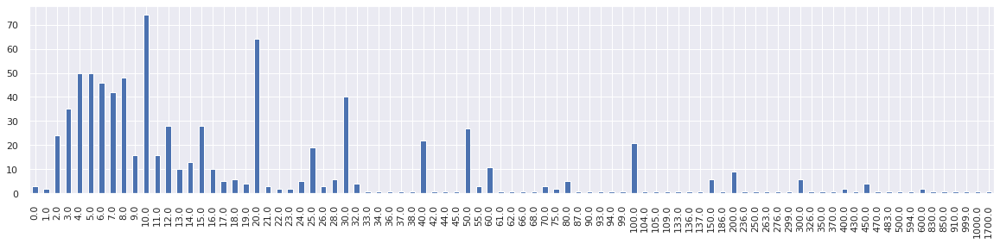

In [ ]:
gdf_parking_poly.replace(
    {'CAPACITY': {'20-25': '25'}},
    inplace=True,
)
gdf_parking_poly['CAPACITY'] = gdf_parking_poly['CAPACITY'].apply(lambda x: pd.to_numeric(x, errors='raise')).astype('float')
gdf_parking_poly['CAPACITY'].value_counts().sort_index().plot.bar(figsize=(20, 4));

#### on map

In [ ]:
base = gdf_map['boundary_L8_base2'].plot(color='white', edgecolor='blue', label='region', legend=True, linewidth=1, linestyle='--', figsize=(64,64))
gdf_roads.query('HIGHWAY == @main_roads').plot(ax=base)
gdf_parking_poly.plot(edgecolor='green', ax=base)
# plt.savefig(fp('img', 'moscow_main_roads_parking_64.png'))
plt.show()

### 	nature_reserve-polygon

In [ ]:
%%time
gdf_nature_poly = reduced_layer(gdf_map, 'nature_reserve_intersect', 'base2', layer_file='nature_reserve-polygon', mode='intersect')

reduced [nature_reserve_intersect_base2] loaded from cache/nature_reserve_intersect_base2.parquet
CPU times: user 18.6 ms, sys: 4.05 ms, total: 22.7 ms
Wall time: 21.2 ms


In [ ]:
describe(gdf_nature_poly)

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
NAME,object,17,0.00%,0,,18,nan,nan,Бирюлёвский дендропарк,Царицыно,nan
NAME_EN,object,9,50.00%,9,,9,nan,nan,nan,nan,nan
NAME_RU,object,3,83.33%,15,,3,nan,nan,nan,nan,nan
LEISURE,object,2,50.00%,9,,9,nan,nan,nan,nan,nan
BOUNDARY,object,1,0.00%,0,,18,nan,nan,protected_area,protected_area,nan
OSM_TYPE,object,1,0.00%,0,,18,nan,nan,relation,relation,nan
OSM_ID,int64,18,0.00%,0,▅▄▁▄█▄▄▁▁▄,18,6182368.05556,3299666.30252,1375854.00000,12684398.00000,6386697.50000
geometry,geometry,18,0.00%,0,,18,nan,nan,nan,nan,nan


In [ ]:
print_value_counts(gdf_nature_poly['LEISURE'])

nan - 9  park - 7  nature_reserve - 2



In [ ]:
base = gdf_map['boundary_L8_base2'].plot(color='white', edgecolor='blue', label='region', legend=True, linewidth=1, linestyle='--', figsize=(16,16))
gdf_nature_poly.plot(color='green', ax=base)
#plt.savefig(Path(dirs['img'], 'moscow_nature_16.png'))
plt.show()

### water-polygon

In [ ]:
%%time
gdf_water_poly = reduced_layer(gdf_map, 'water-polygon', 'base2', mode='intersect')

reduced [water-polygon_base2] loaded from cache/water-polygon_base2.parquet
CPU times: user 35.2 ms, sys: 0 ns, total: 35.2 ms
Wall time: 40.4 ms


In [ ]:
describe(gdf_water_poly)

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
NAME,object,288,79.76%,1281,,325,nan,nan,nan,nan,nan
NAME_EN,object,27,98.19%,1577,,29,nan,nan,nan,nan,nan
NAME_RU,object,26,98.07%,1575,,31,nan,nan,nan,nan,nan
NATURAL,object,2,0.00%,0,,1606,nan,nan,water,wetland,nan
WATERWAY,object,2,99.88%,1604,,2,nan,nan,nan,nan,nan
WETLAND,object,5,92.34%,1483,,123,nan,nan,nan,nan,nan
OSM_TYPE,object,2,0.00%,0,,1606,nan,nan,relation,way,nan
OSM_ID,int64,1606,0.00%,0,█▂▂▃▂▁▁▁▁▁,1606,248763329.49564,271054338.64893,14530.00000,1040781821.00000,142881387.00000
geometry,geometry,1606,0.00%,0,,1606,nan,nan,nan,nan,nan


In [ ]:
base = gdf_map['boundary_L8_base2'].plot(color='white', edgecolor='red', label='region', legend=True, linewidth=1, linestyle='--', figsize=(16,16))
gdf_water_poly.plot(color='blue', ax=base)
#plt.savefig(Path(dirs['img'], 'moscow_water_16.png'))
plt.show()

### landuse-polygon

In [ ]:
%%time
gdf_landuse_poly = reduced_layer(gdf_map, 'landuse-polygon')

original [landuse-polygon] loaded from zip://osm/RU-MOW-ccef5f5b-20221028-ru-shape.zip!data/landuse-polygon.shp
CPU times: user 3.31 s, sys: 277 ms, total: 3.59 s
Wall time: 3.25 s


In [ ]:
describe(gdf_landuse_poly)

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
NAME,object,2992,91.81%,36152,,3224,nan,nan,nan,nan,nan
NAME_EN,object,119,99.70%,39256,,120,nan,nan,nan,nan,nan
NAME_RU,object,86,99.78%,39288,,88,nan,nan,nan,nan,nan
LANDUSE,object,46,0.00%,0,,39376,nan,nan,allotments,zone_of_alienation,nan
RSDNTL,object,8,85.09%,33505,,5871,nan,nan,nan,nan,nan
OSM_TYPE,object,2,0.00%,0,,39376,nan,nan,relation,way,nan
OSM_ID,int64,39376,0.00%,0,█▂▂▂▂▂▂▁▁▁,39376,320678691.29345,308562180.75885,165293.00000,1042435406.00000,232171181.50000
geometry,geometry,39371,0.00%,0,,39376,nan,nan,nan,nan,nan


#### LANDUSE

In [ ]:
print_value_counts(gdf_landuse_poly['LANDUSE'])

grass - 23239        brownfield - 175         landfill - 26                 police - 2            
residential - 6592   railway - 172            greenfield - 24               aquaculture - 1       
industrial - 2154    basin - 155              greenhouse_horticulture - 21  common - 1            
garages - 1755       recreation_ground - 139  plant_nursery - 19            holiday house - 1     
construction - 1269  military - 126           autodrome - 18                apiary - 1            
commercial - 954     cemetery - 117           embassy_compound - 10         garden - 1            
allotments - 514     meadow - 81              winter_sports - 8             healthcare - 1        
retail - 363         farmyard - 72            institutional - 8             hospital - 1          
farmland - 335       logging - 43             churchyard - 6                zone_of_alienation - 1
flowerbed - 323      orchard - 34             education - 4                 vineyard - 1          
religious 

#### RSDNTL

In [ ]:
print_value_counts(gdf_landuse_poly['RSDNTL'])

nan - 33505   urban - 2592     countryside - 1  gated - 1                cottage - 1
rural - 3261  apartments - 13  condominium - 1  vano111ru@yandex.ru - 1



#### on map

In [ ]:
base = gdf_map['boundary_L8_base2'].plot(color='white', edgecolor='red', label='region', legend=True, linewidth=1, linestyle='--', figsize=(32,32))
gdf_landuse_poly.plot(column='LANDUSE', legend=True, ax=base)
#plt.savefig(Path(dirs['img'], 'moscow_landuse_32.png'))
plt.show()

### фильтр мест в которых ничего не может быть размещено в принципе

In [ ]:
exclude_landuses = [
    'industrial',
    'garages',
    'construction',
    'allotments',
    'farmland',
    'reservoir',
    'railway',
    'recreation_ground',
    'cemetery',
    'military',
    'farmyard',
    'orchard',
    'animal_keeping',
    'landfill',
    'plant_nursery',
    'autodrome',
    'zone_of_alienation',
    # 'grass',
    'religious',
    'meadow',
    'greenfield',
    'embassy_compound',
    'churchyard',
    'depot',
    'aquaculture',
    'garden',
    'healthcare',
    'hospital',
]
exclude_man_made =[
    'bridge',
    'tower',
    'pier',
    'wastewater_plant',
    'heat_exchange_station',
    #'tunnel',
    'water_works',
    'embankment',
]
exclude_building = [
    'garages',
    'garage',
    'hospital',
    'church',
    'bridge',
    'chapel',
    'clinic',
]
exclude_leisures = [
    'park',
    #'sport_center',
    'garden',
    'golf_course',
    'marina',
    'beach_resort',
    'resort',
]
exclude_amenity = [
    'place_of_worship',
    'hospital',
    'grave_yard',
]
# gdf_roads_mp = gdf_roads.query('(HIGHWAY == @main_roads) or (WIDTH > 2)')
# gdf_roads_mp.geometry = gdf_roads_mp.geometry.convex_hull
# gdf_roads_mp = gdf_roads_mp[gdf_roads_mp.geometry.geom_type == "Polygon"]

none_places = (
    gdf_water_poly.dissolve()[['geometry']]
    .append(gdf_nature_poly.dissolve()[['geometry']], ignore_index=True)
    .append(gdf_poi_poly.query("(LEISURE in @exclude_leisures) or (AMENITY in @exclude_amenity) or (MAN_MADE in @exclude_man_made)").dissolve()[['geometry']], ignore_index=True)
    .append(gdf_landuse_poly.query('LANDUSE in @exclude_landuses').dissolve()[['geometry']], ignore_index=True)
    #.append(gdf_roads_mp.dissolve()[['geometry']], ignore_index=True)
    #.append(gdf_railway_line.dissolve()[['geometry']], ignore_index=True)
    .append(gdf_building_poly.query("BUILDING in @exclude_building").dissolve()[['geometry']], ignore_index=True)
    .append(gdf_railway_platform.dissolve()[['geometry']], ignore_index=True)
).dissolve()

In [ ]:
none_places.geometry = none_places.geometry.intersection(gdf_map['base2'])

In [ ]:
with set_to_crs(none_places, MOSCOW_CRS):
    none_places.geometry = none_places.geometry.simplify(tolerance=2) #5m

In [ ]:
none_places.to_parquet(fp('cache', 'none_places.parquet'))
save_as_geojson(none_places, 'none_places')

In [ ]:
none_places = none_places.explode()
none_places = none_places[none_places.geom_type == 'Polygon']
with set_to_crs(none_places, MOSCOW_CRS):
    none_places.geometry = none_places.geometry.buffer(10)

none_places = none_places.dissolve()
none_places = none_places.explode()
with set_to_crs(none_places, MOSCOW_CRS):
    none_places['is_fine'] = none_places.geometry.area > 10000
none_places = none_places[none_places['is_fine']]
none_places = none_places.dissolve()
    #todo: close small holes

In [ ]:
none_places.explore()

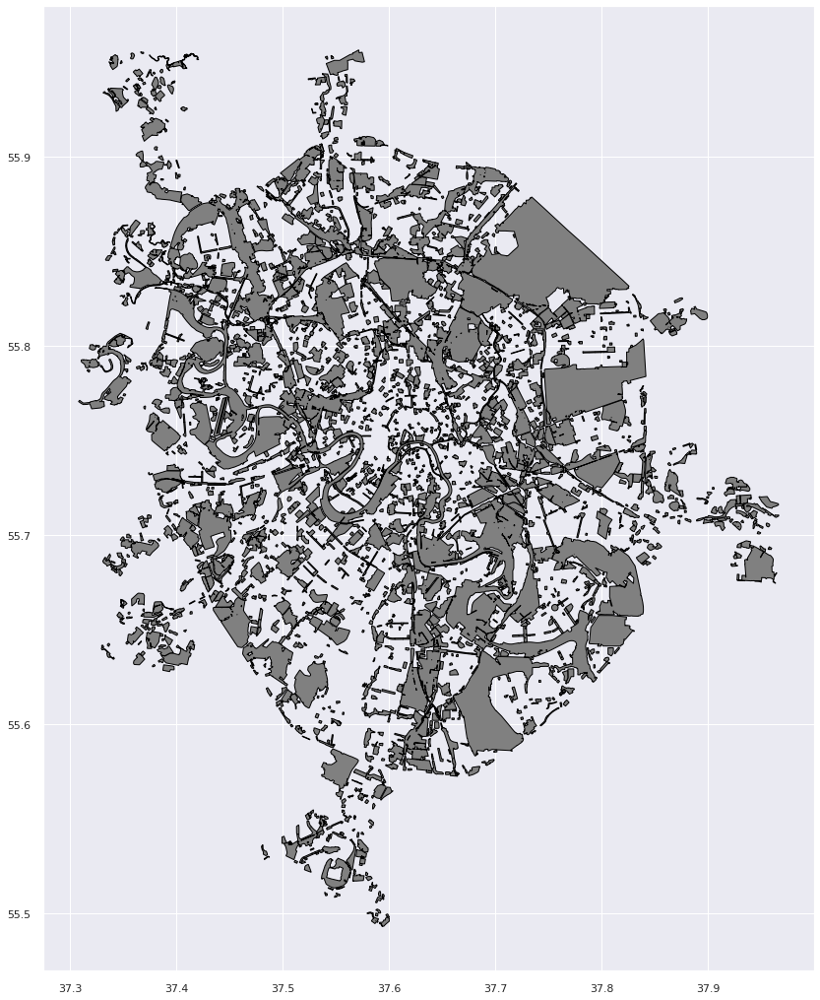

In [ ]:
none_places.plot(color='gray', edgecolor='black', figsize=(18,18))
#plt.savefig(fp('img', 'moscow_none_places_2.png'))

In [ ]:
base = none_places.plot(color='gray', edgecolor='black', figsize=(18,18))
gdf_h3[8].plot(edgecolor='red', alpha=.5, linewidth=2, ax=base);

In [ ]:
# gdf_h3[9].sindex.valid_query_predicates

{None,
 'contains',
 'contains_properly',
 'covered_by',
 'covers',
 'crosses',
 'intersects',
 'overlaps',
 'touches',
 'within'}

In [ ]:
gdf_h3_wm = {} 
for res in range(7,11):
    print(res)
    gdf_h3_wm[res] = gdf_h3[res].loc[
        ~gdf_h3[res].index.isin(
            gpd.sjoin(gpd.GeoDataFrame(geometry=gdf_h3[res].centroid), none_places, how='inner', predicate='within').index
        )]
    save_as_geojson(gdf_h3_wm[res], f'h3_{res}_in_place')
    gdf_h3_wm[res].plot(figsize=(18,18))
    # plt.savefig(fp('img', f'h3_{res}_none_places.png'))
    plt.show()

### отбор мест, в которых маловероятна установка постаматов (негативный семплинг)

In [ ]:
# building
exclude_building = [
    'garages',
    'industrial',
    'kindergarten',
    'construction',
    'college',
    'school',
    'garage',
    'hospital',
    'church',
    'bridge',
    'chapel',
    'clinic',
    'government',
]

# landuses
exclude_landuses = [
    #'industrial',
    'garages',
    'construction',
    'allotments',
    'farmland',
    'reservoir',
    #'railway',
    'recreation_ground',
    'cemetery',
    'military',
    #'farmyard',
    'orchard',
    'animal_keeping',
    'landfill',
    #'plant_nursery',
    'autodrome',
    'zone_of_alienation',
    # 'grass',
    'religious',
    'meadow',
    #'greenfield',
    'embassy_compound',
    'churchyard',
    'depot',
    #'aquaculture',
    #'garden',
    'healthcare',
    'hospital',
]

# poi
exclude_man_made =[
    'bridge',
    'tower',
]

exclude_offices =[
    'research',
    'diplomatic',
    'estate_agent',
    'police',
]

exclude_leisures = [
    'playground',
    'pitch',
    'track',
    'dog_park',
    'park',
    'garden',
]

exclude_amenity = [
    'kindergarten',
    'school',
    'place_of_worship',
    'clinic',
    'shelter',
    'fuel',
    'college',
    'hospital',
    'fountain',
    'police',
    'waste_disposal',
    'fire_station',
    'security_booth',
    'music_school',
    'courthouse',
    'monastery',
    'recycling',
    'mortuary',
    'townhall',
    'prison',
    'grave_yard',
]

p0_places = (
    #gdf_landuse_poly.query('LANDUSE in @exclude_landuses')[['geometry']]
    gdf_building_poly.query("BUILDING in @exclude_building")[['geometry']]
    .append(
        gdf_poi_poly.query("(LEISURE in @exclude_leisures) or (AMENITY in @exclude_amenity) or (OFFICE in @exclude_offices) or (MAN_MADE in @exclude_man_made)")[['geometry']], ignore_index=True)
    .append(
        gdf_poi_points.query("(LEISURE in @exclude_leisures) or (AMENITY in @exclude_amenity) or (OFFICE in @exclude_offices) or (MAN_MADE in @exclude_man_made)")[['geometry']], ignore_index=True)
    #.append(gdf_railway_platform[['geometry']], ignore_index=True)
)
p0_places.shape

(60444, 1)

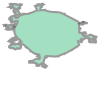

In [ ]:
gdf_map['base2'][0]

In [ ]:
none_places.iloc[0].geometry

In [ ]:
p0_places = p0_places.explode()
p0_places.geometry = p0_places.geometry.centroid
p0_places = p0_places[p0_places.geometry.within(gdf_map['base2'][0])]
p0_places.shape

In [ ]:
# base = p0_places.plot(color='white', edgecolor='red', figsize=(64,64))
# gdf_h3_wm[9].plot(edgecolor='blue', alpha=.3, linewidth=1, ax=base)
# plt.savefig(fp('img', f'p0_places_h3_9.png'))

In [ ]:
# po_h3_11 = p0_places.h3.geo_to_h3(resolution=11)
# po_h3_11 = po_h3_11.groupby('h3_11').first().reset_index() # todo: find nearest to h3 center to make its more spare

In [ ]:
# base = po_h3_11.plot(color='white', edgecolor='red', figsize=(64,64))
# gdf_h3_wm[9].plot(edgecolor='blue', alpha=.3, linewidth=1, ax=base)
# plt.savefig(fp('img', f'p0_places_h3_9_reduced_in_h3_11.png'))

In [ ]:
po_h3_10 = p0_places.h3.geo_to_h3(resolution=10)
po_h3_10 = po_h3_10.groupby('h3_10').first().reset_index() 

In [ ]:
# base = po_h3_10.plot(color='white', edgecolor='red', figsize=(64,64))
# gdf_h3_wm[9].plot(edgecolor='blue', alpha=.3, linewidth=1, ax=base)
# plt.savefig(fp('img', f'p0_places_h3_9_reduced_in_h3_10.png'))

In [ ]:
po_h3_10 = po_h3_10.loc[
    po_h3_10.index.isin(
        gpd.sjoin(po_h3_10, gdf_h3_wm[10], how='inner', predicate='within').index
    )
]

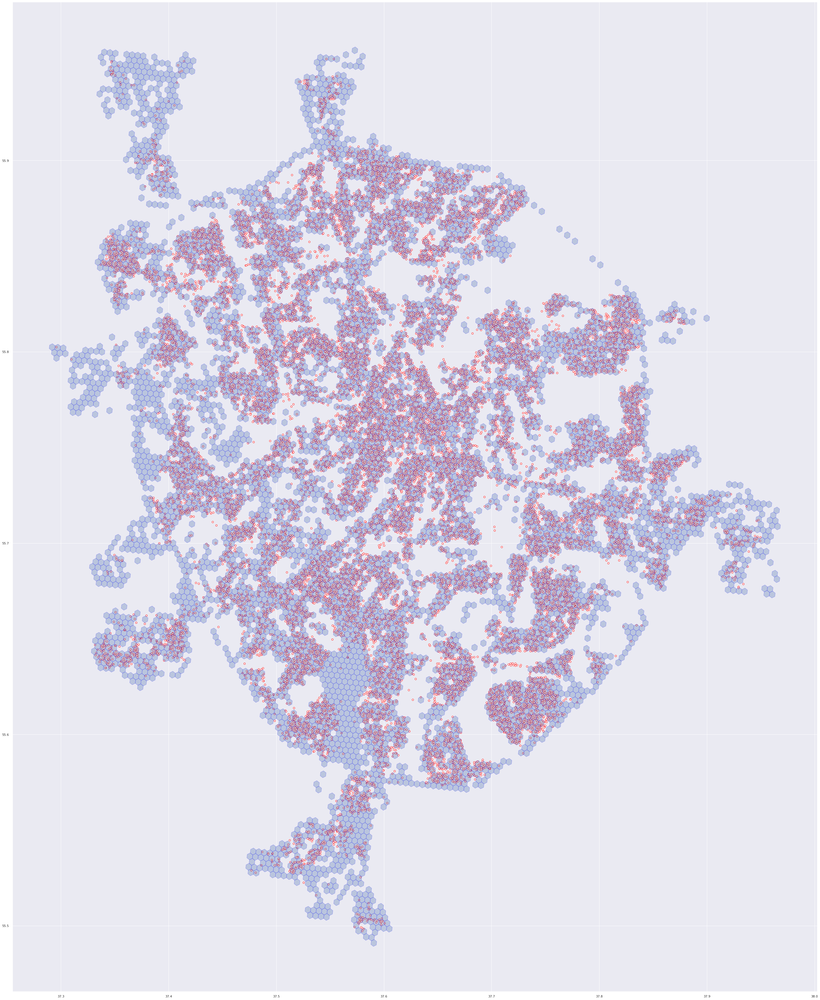

In [ ]:
base = po_h3_10.plot(color='white', edgecolor='red', figsize=(64,64))
gdf_h3_wm[9].plot(edgecolor='blue', alpha=.3, linewidth=1, ax=base)
plt.savefig(fp('img', f'p0_places_h3_9_reduced_in_h3_10.png'))

In [149]:
po_h3_10.shape

(19378, 2)

In [150]:
save_as_geojson(po_h3_10, 'p0_points_in_place_h3_10')

  adding: cache/p0_points_in_place_h3_10.geojson (deflated 88%)
'cache/p0_points_in_place.geojson' -> '/content/drive/MyDrive/pm/cache/p0_points_in_place.geojson'
'cache/p0_points_in_place.geojson.zip' -> '/content/drive/MyDrive/pm/cache/p0_points_in_place.geojson.zip'
'cache/p0_points_in_place_h3_10.geojson' -> '/content/drive/MyDrive/pm/cache/p0_points_in_place_h3_10.geojson'
'cache/p0_points_in_place_h3_10.geojson.zip' -> '/content/drive/MyDrive/pm/cache/p0_points_in_place_h3_10.geojson.zip'


## houses (houses.csv)

In [ ]:
!wc -l houses.csv
!head -2 houses.csv

wc: houses.csv: No such file or directory
head: cannot open 'houses.csv' for reading: No such file or directory


In [ ]:
dfh = pd.read_csv(
    fp('source', 'houses.csv'),
    delimiter=';',
    encoding='cp1251',
    usecols=(
        'id',
        'address',

        'latitude',
        'longtitude',

        'seria',
        'type',

        'entrance',
        'floors',

        'rooms',
        'living_rooms',
        'not_living_rooms',

        'living_square',
        'not_living_square',
        'common_hold_square',
        'underground_square',
        'square',
        'land_plot_area',
        'parking_area',

        'build_year',
        'working_year',
        'energo_class',
        'manager',
        'ext_info',
        'other',

        'wreck',
    ),
)

In [ ]:
dfh.rename({'longtitude': 'longitude'}, axis='columns', inplace=True)

In [ ]:
gdfh = as_gdf_with_points(dfh, 'longitude', 'latitude')

In [ ]:
describe(gdfh)

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
id,int64,34246,0.00%,0,▁▁▁▇██▂▂▂▂,34248,7940092.67105,424624.64779,6489196.00000,9343056.00000,7822752.50000
address,object,34124,0.00%,0,,34248,nan,nan,"аллея. 1 Маевки, д. 11, к. 1","ш. Ярославское, д. 8, к. 2",nan
build_year,object,170,0.00%,0,,34248,nan,nan,1559,Не заполнено,nan
common_hold_square,object,14560,0.00%,0,,34248,nan,nan,0.0,Не заполнено,nan
energo_class,object,9,0.00%,0,,34248,nan,nan,A,Не присвоен,nan
entrance,object,36,0.00%,0,,34248,nan,nan,0,Не заполнено,nan
ext_info,object,410,0.00%,0,,34248,nan,nan,-,"число этажей: 16 + мансарда площадь крыши: 2314 кв.м. площадь застройки: 2726,6 кв.м. число лестниц: 2",nan
floors,object,57,0.00%,0,,34248,nan,nan,0,Не заполнено,nan
land_plot_area,object,7340,0.00%,0,,34248,nan,nan,0.0,Не заполнено,nan
latitude,float64,25669,0.08%,26,▁▁▁▁▁▁▁█▆▁,34222,55.74176,0.12075,46.95179,57.96755,55.74946


##### filters

In [ ]:
gdfh.dropna(subset=('longitude', 'latitude'), inplace=True)

In [ ]:
gdfh.drop(gdfh[~gdfh.geometry.within(gdf_map['boundary_L8_base2'].geometry.unary_union)].index, axis='index', inplace=True)

In [ ]:
gdfh.shape

(31760, 26)

##### nulls

In [ ]:
gdfh.replace(
    {'Не заполнено': pd.NA},
    inplace=True,
)

In [ ]:
describe(gdfh)

,dtype,uniques#,nulls%,nulls#,hist,count,mean,std,min,max,q0.50
id,int64,31758,0.00%,0,▁▁█▅▆▂▁▁▂▁,31760,7911514.77717,385186.82832,7012247.00000,9342962.00000,7812532.50000
address,object,31671,0.00%,0,,31760,nan,nan,"аллея. 1 Маевки, д. 11, к. 1","ш. Ярославское, д. 8, к. 2",nan
build_year,object,168,9.55%,3034,,28726,nan,nan,nan,nan,nan
common_hold_square,object,13501,11.82%,3753,,28007,nan,nan,nan,nan,nan
energo_class,object,8,12.40%,3937,,27823,nan,nan,nan,nan,nan
entrance,object,29,2.50%,793,,30967,nan,nan,nan,nan,nan
ext_info,object,369,53.84%,17100,,14660,nan,nan,nan,nan,nan
floors,object,50,2.51%,796,,30964,nan,nan,nan,nan,nan
land_plot_area,object,6588,9.14%,2902,,28858,nan,nan,nan,nan,nan
latitude,float64,23791,0.00%,0,▁▁▃▅▆██▅▄▁,31760,55.75105,0.08295,55.50058,55.94951,55.75533


In [ ]:
gdfh['floors'].unique()

array(['4', '3', '2', '5', '17', '9', '12', <NA>, '1', '13', '11', '22',
       '14', '10', '25', '6', '16', '8', '7', '18', '24', '23', '26',
       '34', '33', '35', '49', '21', '15', '20', '19', '28', '30', '31',
       '0', '37', '27', '32', '40', '42', '48', '29', '38', '58', '45',
       '53', '1960', '50', '39', '44', '57'], dtype=object)

In [ ]:
gdfh.query('floors == "1960"')

,id,address,build_year,common_hold_square,energo_class,entrance,ext_info,floors,land_plot_area,latitude,living_rooms,living_square,longitude,manager,not_living_rooms,not_living_square,other,parking_area,rooms,seria,square,type,underground_square,working_year,wreck,geometry
18890,7724117,"ул. Мосфильмовская, д. 33",1959,0.0,C,4,Не имеется,1960,0.0,55.71232,80,3404.9,37.51163,"ГБУ ""Жилищник района Раменки""",0,0.0,Не имеется,0.00,80,индивидуальный,3404.9,Многоквартирный дом,608.9,1959,Нет,POINT (37.51163 55.71232)


In [ ]:
gdfh['floors'].replace({'1960': '8'}, inplace=True)

In [ ]:
gdfh['entrance'].unique()

array(['4', '2', '3', '6', <NA>, '1', '11', '7', '8', '5', '9', '14',
       '13', '15', '10', '24', '12', '16', '18', '17', '20', '22', '27',
       '0', '19', '26', '25', '23', '33', '21'], dtype=object)

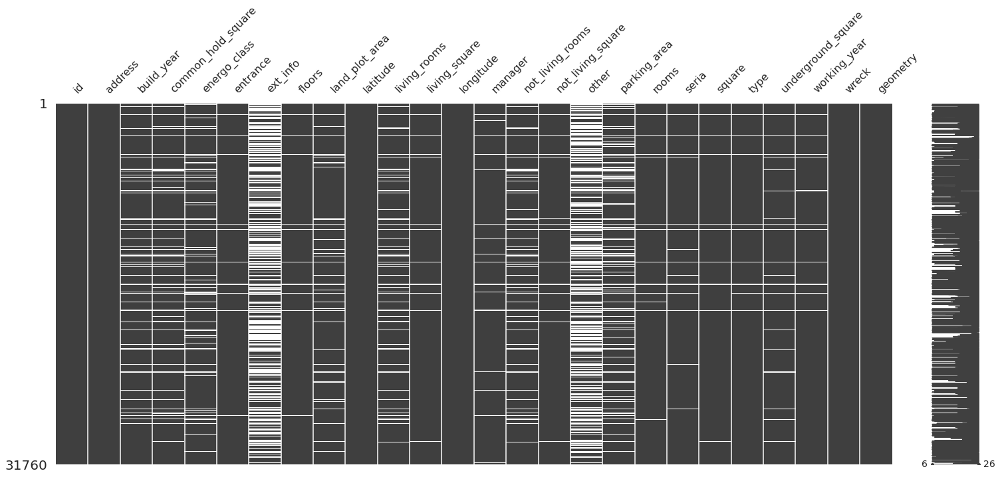

In [ ]:
msno.matrix(gdfh);

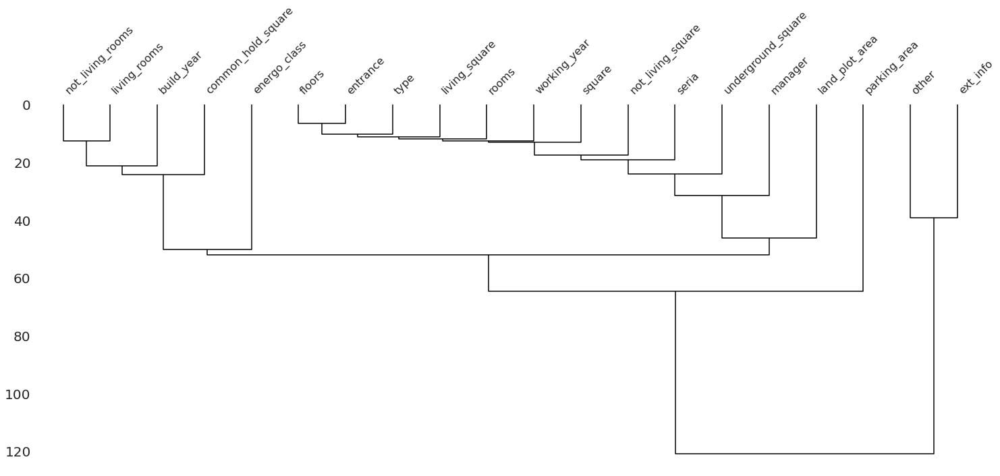

In [ ]:
msno.dendrogram(gdfh.loc[:, gdfh.isna().any().loc[lambda s: s].index]);

In [ ]:
gdfh.fillna({'parking_area': 0, 'land_plot_area': 0}, inplace=True)
gdfh[['parking_area', 'land_plot_area']] = gdfh[['parking_area', 'land_plot_area']].apply(lambda x: pd.to_numeric(x.str.replace(' ', ''), errors='raise'))

In [ ]:
gdfh.dropna(subset=['not_living_rooms', 'living_rooms', 'rooms'], thresh=1, inplace=True)
gdfh.fillna({'not_living_rooms':0, 'living_rooms':0, 'rooms':0}, inplace=True)
gdfh[['not_living_rooms', 'living_rooms', 'rooms']] = gdfh[['not_living_rooms', 'living_rooms', 'rooms']].apply(lambda x: pd.to_numeric(x, errors='raise')).astype('int')

In [ ]:
gdfh.dropna(subset=['not_living_square', 'living_square', 'square'], thresh=1, inplace=True)
gdfh.fillna({'not_living_square':0, 'living_square':0, 'square':0}, inplace=True)
gdfh[['not_living_square', 'living_square', 'square']] = gdfh[['not_living_square', 'living_square', 'square']].apply(lambda x: pd.to_numeric(x, errors='raise')).astype('int')

In [ ]:
gdfh.dropna(subset=['floors', 'entrance'], thresh=2, inplace=True)

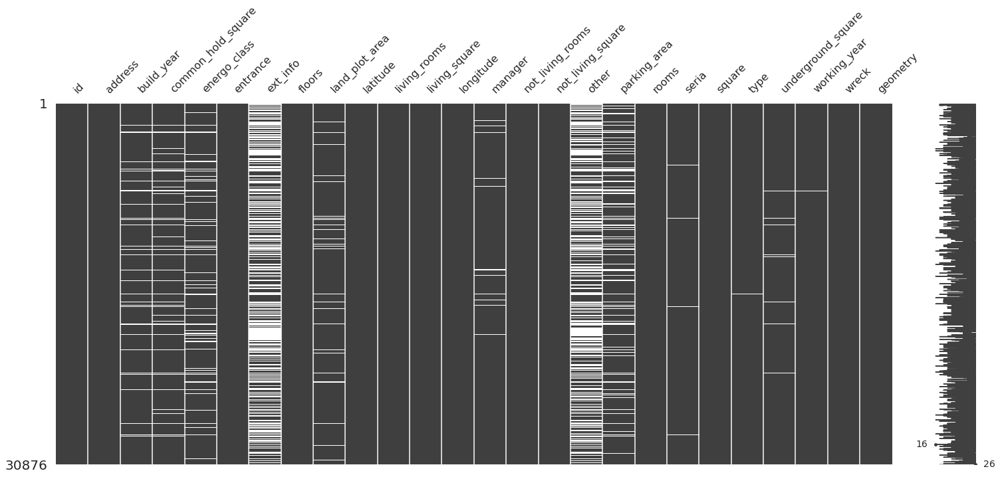

In [ ]:
msno.matrix(gdfh);

##### floors

In [ ]:
gdfh['floors'] = gdfh['floors'].apply(lambda x: pd.to_numeric(x, errors='raise')).astype('int')

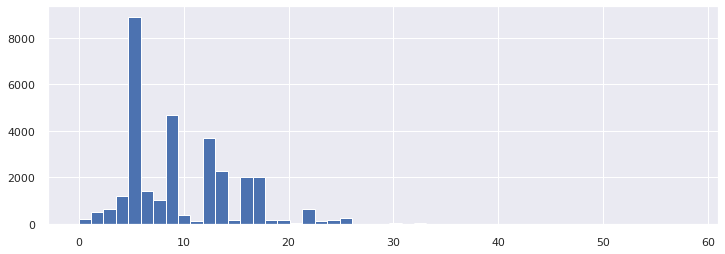

In [ ]:
gdfh.floors.hist(bins=gdfh.floors.nunique(), figsize=(12,4));

##### entrance

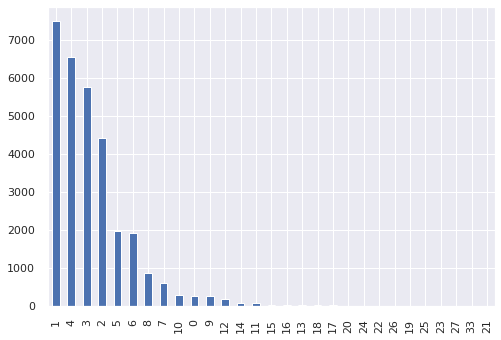

In [ ]:
gdfh['entrance'].value_counts().plot.bar();

##### map

In [ ]:
gdfh['cat_floors'] = pd.cut(gdfh['floors'], [0,3,5,12,17,25,100], labels=['<=3','<=5','<=12','<=18','<=25','25+'])

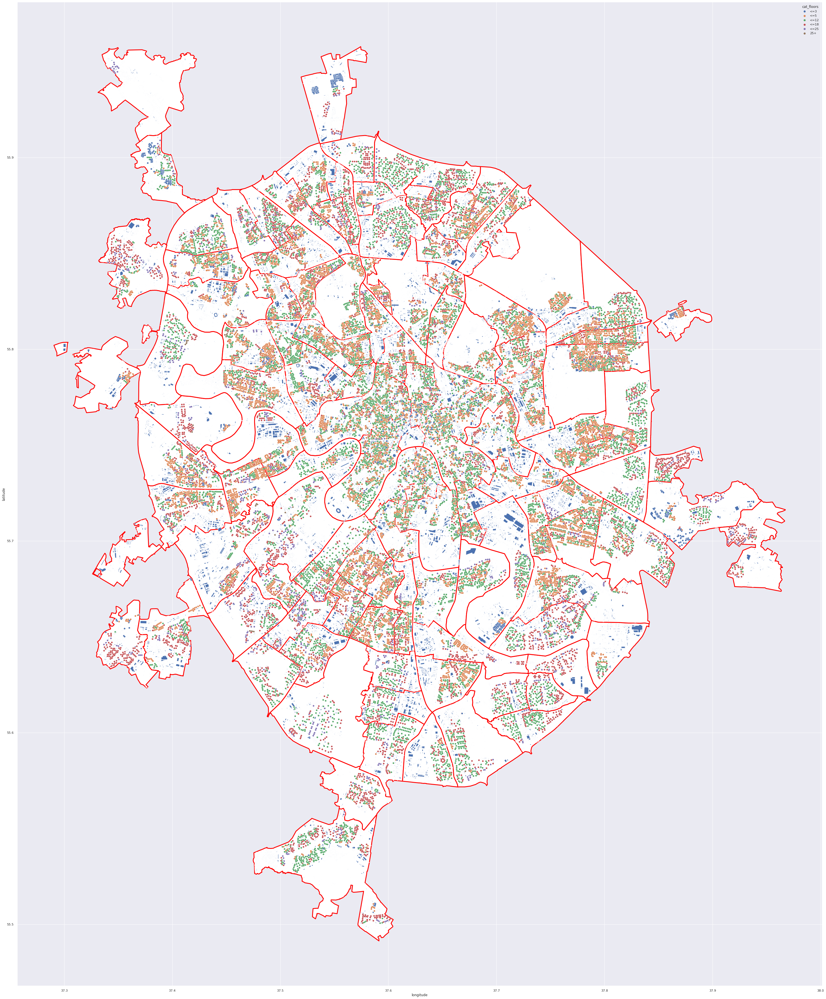

In [ ]:
base = gdf_map['boundary_L8_base2'].plot(color='white', edgecolor='red', linewidth=3, figsize=(64,64)) # alpha=.8, 
gdf_map['building_polygon_base2'].plot(ax=base)
sns.scatterplot(data=gdfh, x='longitude', y='latitude', hue='cat_floors', ax=base);

In [ ]:
# plt.figure(figsize=(64,64))
# sns.scatterplot(data=dfh, x='longtitude', y='latitude', hue='type');
# dfh.plot.scatter('longtitude', 'latitude', figsize=(64,64));

## houses pm v10

In [ ]:
# dfhp = pd.read_excel(fp('cache', 'houses_pm_v10.xlsx'))

In [ ]:
# describe(dfhp)

In [ ]:
# dfhp.columns = ['n_top', 'n', 'address', 'area', 'year', 'floors', 'entrance', 'rooms']

In [ ]:
# dfhp.sample(3)

In [ ]:
# len(dfhp.address.str.endswith(', Москва'))

In [ ]:
# dfhp.address = dfhp.address.str.replace(', Москва', '')

# draft

In [ ]:
# def close_holes(poly: Polygon) -> Polygon:
#         """
#         Close polygon holes by limitation to the exterior ring.
#         Args:
#             poly: Input shapely Polygon
#         Example:
#             df.geometry.apply(lambda p: close_holes(p))
#         """
#         if poly.interiors:
#             return Polygon(list(poly.exterior.coords))
#         else:
#             return poly

https://github.com/uber/h3/issues/275

In [ ]:
# def covering_cells_from_geometry(geometry, res):
#     """ 
#     :param geometry: pygeos geometry
#     :param res: desired h3 resolution
#     :return: set of h3 indexes
#     """
#     buffer_width = statistics.mean(
#         [
#             h3.exact_edge_length(e, unit="rads")
#             for e in h3.get_h3_unidirectional_edges_from_hexagon(
#                 h3.geo_to_h3(
#                     *pygeos.get_coordinates(pygeos.centroid(geometry))[0][::-1],
#                     resolution=res
#                 )
#             )
#         ]
#     ) * (180 / math.pi)

#     buffered_geometry_parts = pygeos.get_parts(
#         pygeos.buffer(geometry, buffer_width, join_style="mitre")
#     )

#     return reduce(
#         or_,
#         [
#             h3.polyfill_polygon(
#                 pygeos.coordinates.get_coordinates(p),
#                 res=res,
#                 lnglat_order=True,
#             )
#             for p in buffered_geometry_parts
#         ] or [set()],
#     )

## 3

In [ ]:
# def display_hexagons_on_map(hexagons, color="red", width=4, folium_map=None):

#     polylines = []
#     lat = []
#     lng = []
#     for hex in hexagons:
#         polygons = h3.h3_set_to_multi_polygon([hex], geo_json=False)
#         outlines = [loop for polygon in polygons for loop in polygon]
#         polyline = [outline + [outline[0]] for outline in outlines][0]
#         lat.extend(map(lambda v:v[0],polyline))
#         lng.extend(map(lambda v:v[1],polyline))
#         polylines.append(polyline)
    
#     if folium_map is None:
#         m = folium.Map(location=[sum(lat)/len(lat), sum(lng)/len(lng)], zoom_start=20, tiles='cartodbpositron')
#     else:
#         m = folium_map
        
#     for polyline in polylines:
#         my_PolyLine=folium.PolyLine(locations=polyline,weight=width,color=color)
#         m.add_child(my_PolyLine)
#     return m

# loc = (55.83016, 37.6644)
# display_hexagons_on_map([h3.geo_to_h3(*loc, i) for i in range(10, 6, -1)], width=1)

In [ ]:
# display_hexagons_on_map(h3.k_ring(h3.geo_to_h3(*loc, 10), 4), color='blue', width=1)

In [ ]:
# def osm_query(tag, city):
#     gdf = ox.geometries_from_place(city, tag).reset_index()
#     gdf['city'] = np.full(len(gdf), city.split(',')[0])
#     gdf['object'] = np.full(len(gdf), list(tag.keys())[0])
#     gdf['type'] = np.full(len(gdf), tag[list(tag.keys())[0]])
#     gdf = gdf[['city', 'object', 'type', 'geometry']]
#     print(gdf.shape)
#     return gdf
  
# tags = [
#         {'building' : 'apartments'}, {'building' : 'detached'}, 
#         {'building' : 'dormitory'}, {'building' : 'hotel'}, 
#         {'building' : 'house'}, {'building' : 'semidetached_house'}, 
#         {'building' : 'terrace'},  {'building' : 'commercial'},
#         {'building' : 'office'},  {'building' : 'terrace'},  
#         {'building' : 'terrace'}, {'building':'retail'}, 
#         {'building':'train_station'},
#         {'highway' : 'bus_stop'}, {'footway':'crossing'},
#         {'amenity':'cafe'}, {'amenity':'fast_food'}, 
#         {'amenity':'restaurant'}, {'amenity':'college'}, 
#         {'amenity':'language_school'},  {'amenity':'school'},  
#         {'amenity':'university'},  {'amenity':'atm'},  
#         {'amenity':'bank'},  {'amenity':'clinic'},  
#         {'amenity':'hospital'},  {'amenity':'pharmacy'},  
#         {'amenity':'theatre'},  {'amenity':'townhall'},  
#         {'amenity':'bench'}, 
#        ]
# cities = ['Москва, Россия']

# gdfs = []
# for city in cities:
#     for tag in tags:
#         gdfs.append(osm_query(tag, city))
        
# data_poi = pd.concat(gdfs)
# data_poi.groupby(['city','object','type'], as_index = False).agg({'geometry':'count'})

# lat, lon = get_lat_lon(data_poi['geometry'])
# data_poi['lat'] = lat
# data_poi['lon'] = lon

In [ ]:
# # sjoin - spatial join - пересекаем гексагоны с объектами (определяем какие объекты находятся в разрезе каждого гексагона)

# gdf_1 = gpd.GeoDataFrame(data_poi, geometry=gpd.points_from_xy(data_poi.lon, data_poi.lat))

# gdf_2 = pd.DataFrame(polygons, columns = ['geometry'])
# gdf_2['polylines'] = polylines
# gdf_2['geometry'] = gdf_2['geometry'].astype(str)
# geometry_uniq = pd.DataFrame(gdf_2['geometry'].drop_duplicates())
# geometry_uniq['id'] = np.arange(len(geometry_uniq)).astype(str)
# gdf_2 = gdf_2.merge(geometry_uniq, on = 'geometry')
# gdf_2['geometry'] = gdf_2['geometry'].apply(wkt.loads)
# gdf_2 = gpd.GeoDataFrame(gdf_2, geometry='geometry')

# itog_table = gpd.sjoin(gdf_2, gdf_1, how='left', op='intersects')
# itog_table = itog_table.dropna()
# itog_table.head()

In [ ]:
# def create_choropleth(data, json, columns, legend_name, feature, bins):
    
#     lat, lon = get_lat_lon(data['geometry'])

#     m = folium.Map(location=[sum(lat)/len(lat), sum(lon)/len(lon)], zoom_start=13, tiles='cartodbpositron')
    
#     folium.Choropleth(
#         geo_data=json,
#         name="choropleth",
#         data=data,
#         columns=columns,
#         key_on="feature.id",
#         fill_color="YlGn",
#         fill_opacity=0.7,
#         line_opacity=0.2,
#         legend_name=legend_name,
#         nan_fill_color = 'black',
#         bins = bins

#     ).add_to(m)

#     folium.LayerControl().add_to(m)

#     return m
  
# # подготовим данные 
# itog_table['geometry'] = itog_table['geometry'].astype(str) #для groupby
# itog_table['id'] = itog_table['id'].astype(str) #для Choropleth
# agg_all = itog_table.groupby(['geometry','type','id'], as_index = False).agg({'lat':'count'}).rename(columns = {'lat':'counts'})
# agg_all['geometry'] = agg_all['geometry'].apply(wkt.loads) #возвращаем формат геометрий

# agg_all_cafe = agg_all.query("type == 'cafe'")[["geometry","counts",'id']]
# agg_all_cafe['id'] = agg_all_cafe['id'].astype(str)
# data_geo_1 = gpd.GeoSeries(agg_all_cafe.set_index('id')["geometry"]).to_json()

# create_choropleth(agg_all_cafe, data_geo_1, ["id","counts"], 'Cafe counts', 'counts', 5)
   

In [ ]:
# def create_heatmap(data, lat_lon_feature):
    
#     m = folium.Map(location=[sum(data['lat'])/len(data['lat']), sum(data['lon'])/len(data['lon'])], zoom_start=13, tiles='cartodbpositron')
    
#     HeatMap(data[lat_lon_feature].groupby(lat_lon_feature[0:2]).sum().reset_index().values.tolist(), 
#                     radius = 70, min_opacity = 0.05, max_val = int((data[lat_lon_feature[2]]).quantile([0.75])), blur=30).add_to(m)
#     return m
  
# create_heatmap(table_people, ['lat', 'lon', 'count_people'])

## geopandas

In [ ]:
#https://gis.stackexchange.com/questions/222315/finding-nearest-point-in-other-geodataframe-using-geopandas

In [ ]:
# from shapely.geometry import Point, Polygon
# from shapely.ops import nearest_points

# poly = Polygon([(0, 0), (2, 8), (14, 10), (6, 1)])
# point = Point(12, 4)
# # The points are returned in the same order as the input geometries:
# p1, p2 = nearest_points(poly, point)
# print(p1.wkt)
# # POINT (10.13793103448276 5.655172413793103)
# The result is the same as in the other answer:

# from shapely.geometry import LinearRing
# pol_ext = LinearRing(poly.exterior.coords)
# d = pol_ext.project(point)
# p = pol_ext.interpolate(d)
# print(p.wkt)
# # POINT (10.13793103448276 5.655172413793103)
# print(p.equals(p1))
# # True

In [ ]:
# import itertools
# from operator import itemgetter

# import geopandas as gpd
# import numpy as np
# import pandas as pd

# from scipy.spatial import cKDTree
# from shapely.geometry import Point, LineString

# gpd1 = gpd.GeoDataFrame([['John', 1, Point(1, 1)],
#                          ['Smith', 1, Point(2, 2)],
#                          ['Soap', 1, Point(0, 2)]],
#                         columns=['Name', 'ID', 'geometry'])
# gpd2 = gpd.GeoDataFrame([['Work', LineString([Point(100, 0), Point(100, 1)])],
#                          ['Shops', LineString([Point(101, 0), Point(101, 1), Point(102, 3)])],
#                          ['Home',  LineString([Point(101, 0), Point(102, 1)])]],
#                         columns=['Place', 'geometry'])


# def ckdnearest(gdfA, gdfB, gdfB_cols=['Place']):
#     # resetting the index of gdfA and gdfB here.
#     gdfA = gdfA.reset_index(drop=True)
#     gdfB = gdfB.reset_index(drop=True)
#     A = np.concatenate(
#         [np.array(geom.coords) for geom in gdfA.geometry.to_list()])
#     B = [np.array(geom.coords) for geom in gdfB.geometry.to_list()]
#     B_ix = tuple(itertools.chain.from_iterable(
#         [itertools.repeat(i, x) for i, x in enumerate(list(map(len, B)))]))
#     B = np.concatenate(B)
#     ckd_tree = cKDTree(B)
#     dist, idx = ckd_tree.query(A, k=1)
#     idx = itemgetter(*idx)(B_ix)
#     gdf = pd.concat(
#         [gdfA, gdfB.loc[idx, gdfB_cols].reset_index(drop=True),
#          pd.Series(dist, name='dist')], axis=1)
#     return gdf

# c = ckdnearest(gpd1, gpd2)

In [ ]:
# from shapely.ops import nearest_points
# # unary union of the gpd2 geomtries 
# pts3 = gpd2.geometry.unary_union
# def near(point, pts=pts3):
#      # find the nearest point and return the corresponding Place value
#      nearest = gpd2.geometry == nearest_points(point, pts)[1]
#      return gpd2[nearest].Place.get_values()[0]
# gpd1['Nearest'] = gpd1.apply(lambda row: near(row.geometry), axis=1)
# gpd1
# #     Name  ID     geometry  Nearest
# # 0   John   1  POINT (1 1)     Home
# # 1  Smith   1  POINT (2 2)    Shops
# # 2   Soap   1  POINT (0 2)     Work
# Explication

# for i, row in gpd1.iterrows():
#     print nearest_points(row.geometry, pts3)[0], nearest_points(row.geometry, pts3)[1]
# #  POINT (1 1) POINT (1 1.1)
# #  POINT (2 2) POINT (2.5 2)
# #  POINT (0 2) POINT (0 1.1)

# faq
- [H3: Area Variation](https://observablehq.com/@nrabinowitz/h3-area-variation)

## libs
- https://geojson.io/#map=15.47/55.827892/37.662938
- osmnx
    - https://osmnx.readthedocs.io/en/stable/osmnx.html
- h3
    - https://h3geo.org/docs/api/indexing
    - https://github.com/uber/h3-py-notebooks/tree/master/notebooks
    - https://github.com/uber/h3-py-notebooks/blob/master/notebooks/urban_analytics.ipynb
- H3Pandas
    - https://github.com/DahnJ/H3-Pandas
    - https://h3-pandas.readthedocs.io/en/latest/h3pandas.html
    - https://nbviewer.org/github/DahnJ/H3-Pandas/blob/master/notebook/00-intro.ipynb
    - https://github.com/DahnJ/H3-Pandas/blob/master/notebook/01-unified-data-layers.ipynb
    - https://h3-pandas.readthedocs.io/en/latest/notebook/01-unified-data-layers.html

- https://jakevdp.github.io/PythonDataScienceHandbook/01.07-timing-and-profiling.html